In [1]:
import os
import numpy as np
import matplotlib.pyplot as plt
from scipy.interpolate import *
from scipy import signal
import librosa
import librosa.display
from IPython.display import Audio
%matplotlib inline

## 2 channel jumps

In [2]:
CALIBRATION_BASEPATH = 'data/measurment-1/calibrations/'
CALIBRATION_FILE_A = '230320-010-calibration-A-20dB.wav'
CALIBRATION_FILE_B = '230320-011-calibration-B-20dB.wav'

calibration_path_A = os.path.join(CALIBRATION_BASEPATH, CALIBRATION_FILE_A)
calibration_path_B = os.path.join(CALIBRATION_BASEPATH, CALIBRATION_FILE_B)

In [3]:
AUDIO_BASEPATH = 'data/measurment-1/jumps/'
AUDIO_FILE = '230320-009-jump-2.wav'

audio_path = os.path.join(AUDIO_BASEPATH, AUDIO_FILE)

In [4]:
os.makedirs('graphs', exist_ok=True)

In [5]:
audio, sr = librosa.load(audio_path, sr=None, mono=False)
audio_2_channels = audio

length = audio.shape[1] / sr

In [6]:
print('Audio length: {:.2f} seconds'.format(length))
print('Sample rate: {} Hz'.format(sr))
print('Hydrophone A')

Audio(audio[0], rate=sr)

Audio length: 20.00 seconds
Sample rate: 48000 Hz
Hydrophone A


In [7]:
print('Audio length: {:.2f} seconds'.format(length))
print('Sample rate: {} Hz'.format(sr))
print('Hydrophone B')

Audio(audio[1], rate=sr)

Audio length: 20.00 seconds
Sample rate: 48000 Hz
Hydrophone B


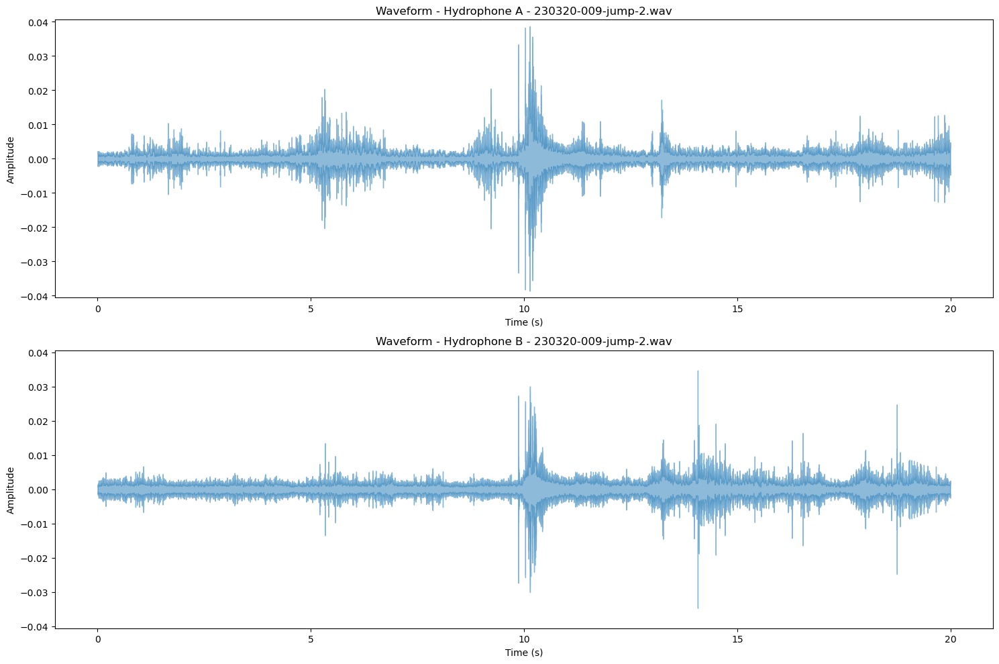

In [8]:
y_max = np.max(np.abs(audio)) * 1.05

plt.figure(figsize=(15, 10))

plt.subplot(2, 1, 1)
librosa.display.waveshow(audio[0], sr=sr, alpha=0.5)
plt.ylim(-y_max, y_max)
plt.title(f'Waveform - Hydrophone A - {AUDIO_FILE}')
plt.ylabel('Amplitude')
time_unit = 'min' if audio.shape[1] / sr > 60 else 's'
plt.xlabel(f'Time ({time_unit})')

plt.subplot(2, 1, 2)
librosa.display.waveshow(audio[1], sr=sr, alpha=0.5)
plt.ylim(-y_max, y_max)
plt.title(f'Waveform - Hydrophone B - {AUDIO_FILE}')
plt.ylabel('Amplitude')
time_unit = 'min' if audio.shape[1] / sr > 60 else 's'
plt.xlabel(f'Time ({time_unit})')

plt.tight_layout()

audio_file_name = AUDIO_FILE.replace('.wav', '')
plt.savefig(f'graphs/waveform-{audio_file_name}.png', dpi=300)
plt.show()

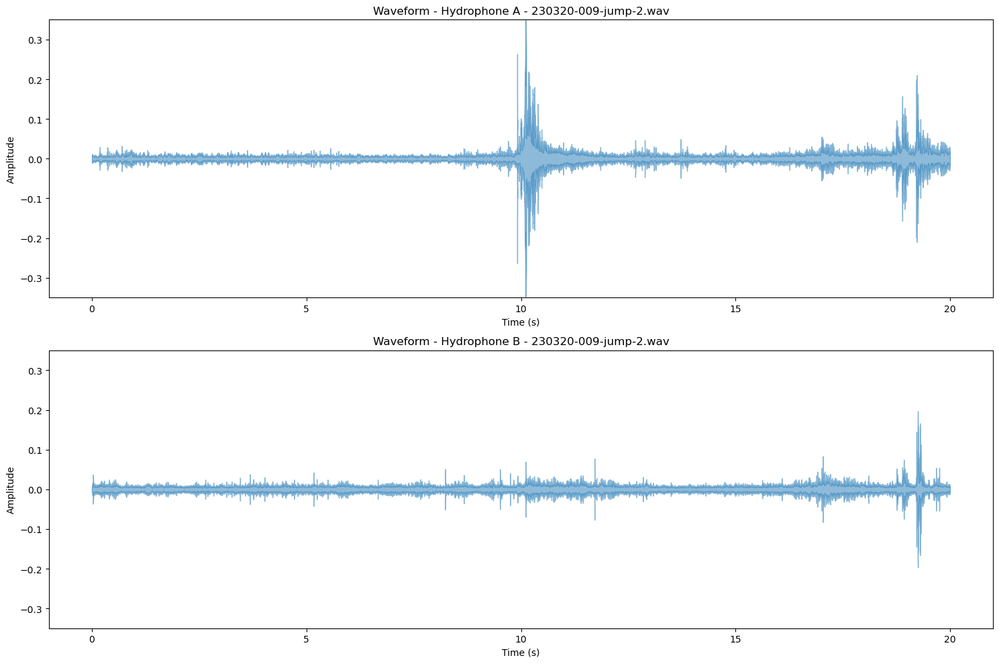

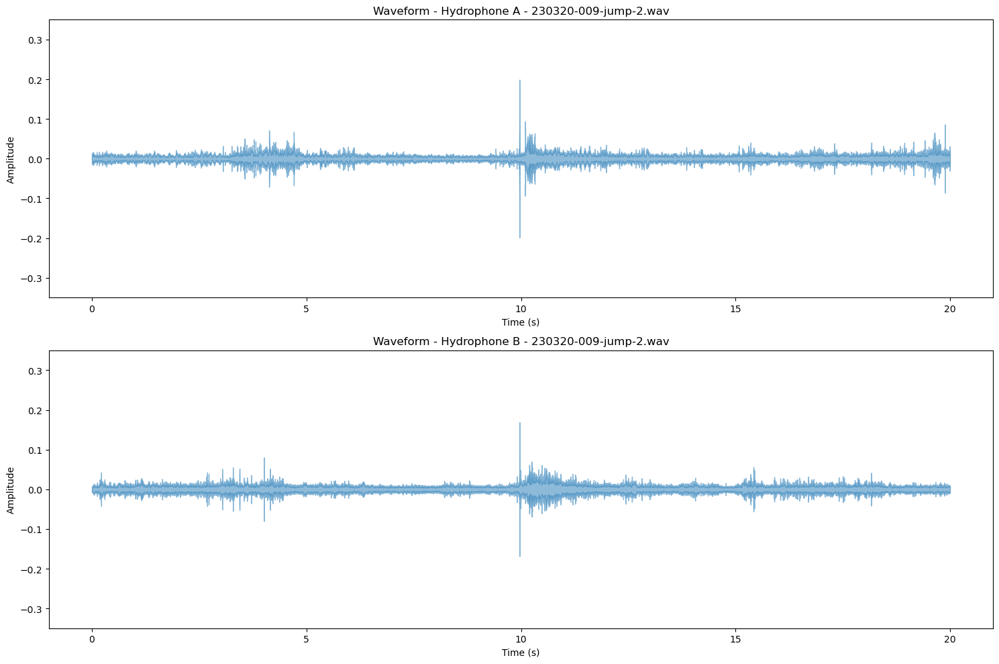

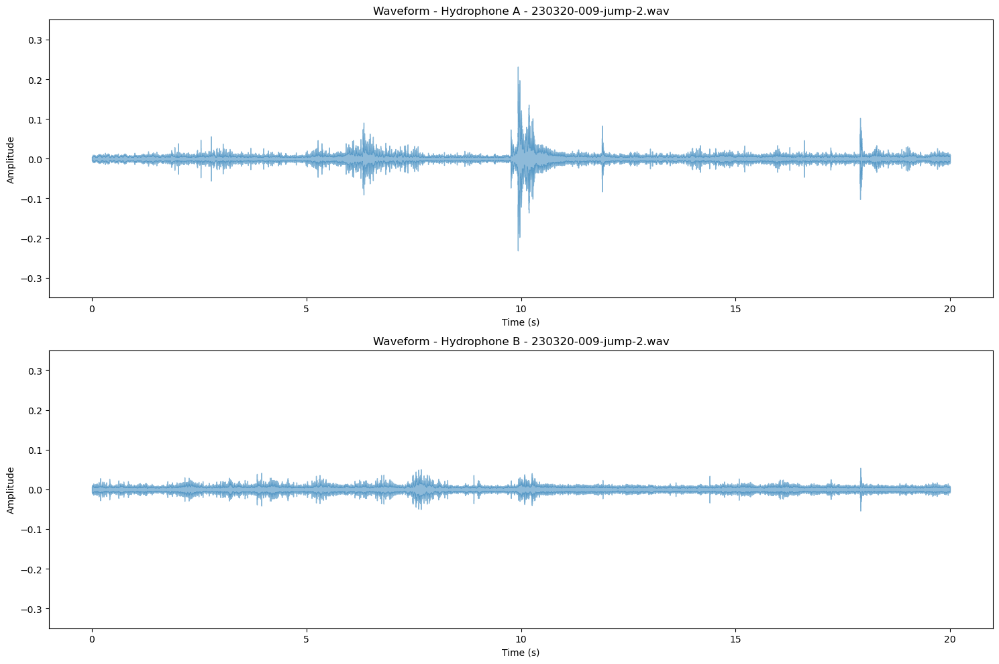

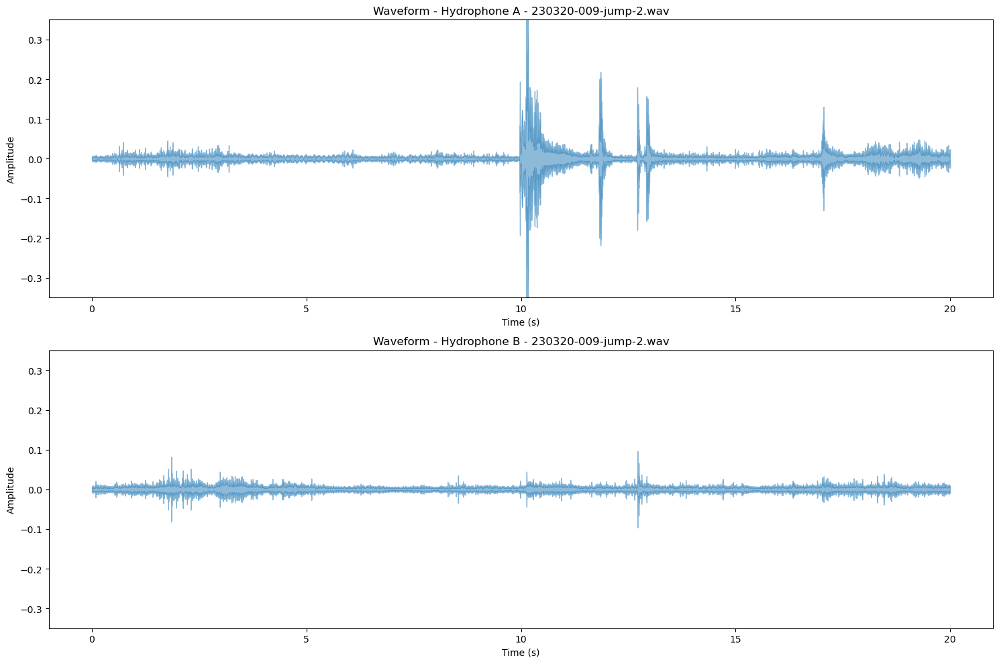

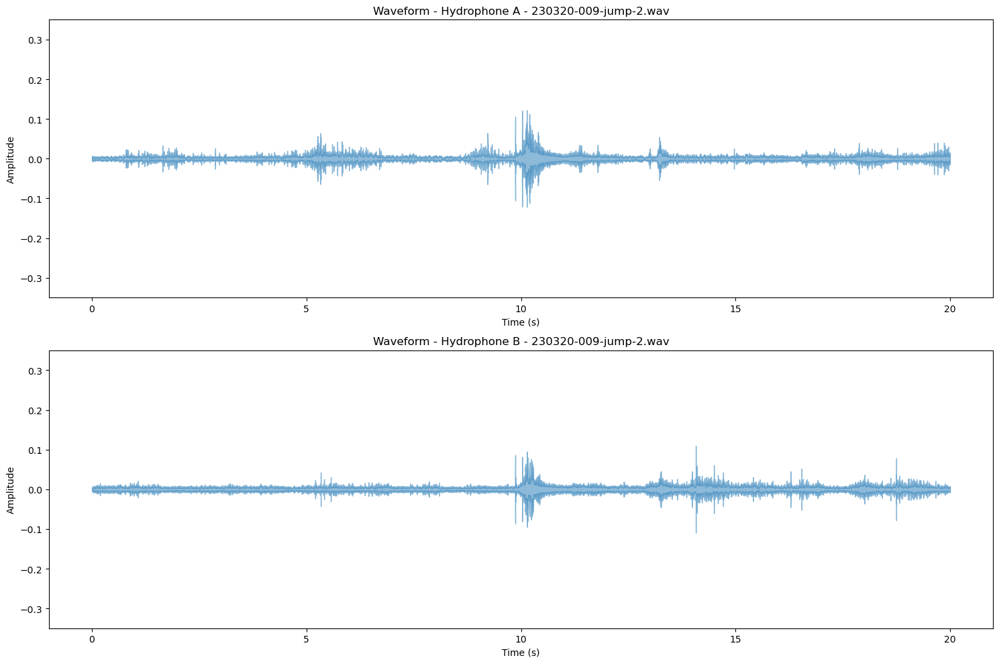

In [9]:
Y_MAX = 0.35

jump_files = list(sorted(os.listdir(AUDIO_BASEPATH)))
gains = [30, 30, 30, 10, 10]

for idx, (jump_file, gain) in enumerate(zip(jump_files, gains)):
    audio_path = os.path.join(AUDIO_BASEPATH, jump_file)
    
    audio, sr = librosa.load(audio_path, sr=None, mono=False)

    audio = audio * 10 ** (gain / 20)

    plt.figure(figsize=(15, 10))

    plt.subplot(2, 1, 1)
    librosa.display.waveshow(audio[0], sr=sr, alpha=0.5)
    plt.ylim(-Y_MAX, Y_MAX)
    plt.title(f'Waveform - Hydrophone A - {AUDIO_FILE}')
    plt.ylabel('Amplitude')
    time_unit = 'min' if audio.shape[1] / sr > 60 else 's'
    plt.xlabel(f'Time ({time_unit})')

    plt.subplot(2, 1, 2)
    librosa.display.waveshow(audio[1], sr=sr, alpha=0.5)
    plt.ylim(-Y_MAX, Y_MAX)
    plt.title(f'Waveform - Hydrophone B - {AUDIO_FILE}')
    plt.ylabel('Amplitude')
    time_unit = 'min' if audio.shape[1] / sr > 60 else 's'
    plt.xlabel(f'Time ({time_unit})')

    plt.tight_layout()

    audio_file_name = AUDIO_FILE.replace('.wav', '')
    plt.savefig(f'graphs/waveform-{audio_file_name}.png', dpi=300)
    plt.show()

In [10]:
REF_EFF = 20e-5 # Pa
CAL_SPL = 123.8 # dB

def calculate_calibration_gain(calibration_path, ref_eff=REF_EFF, cal_spl=CAL_SPL, printing=True):
    calibration, sr = librosa.load(calibration_path, sr=None, mono=True)
    length = calibration.shape[0] / sr
    
    calibration_rms = np.sqrt(np.mean(calibration**2))
    calibration_rms_db = 20 * np.log10(calibration_rms / 1)
    calibration_spl = 20 * np.log10(calibration_rms / ref_eff)

    gain_db = calibration_spl - cal_spl
    calibration_gain = 10**(gain_db / 20)

    if printing:
        print(f'Calibration file: {calibration_path}')
        print(f'Calibration length: {length:.2f} seconds')
        print(f'Calibration RMS: {calibration_rms_db:.2f} dB (ref 1 Pa)')
        print(f'Calibration SPL: {calibration_spl:.2f} dB (ref 20 uPa)')
        print(f'Calibration gain: {gain_db:.2f} dB ({calibration_gain})')
        print()
    
    return calibration_gain

calibration_gain_A = calculate_calibration_gain(calibration_path_A)
calibration_gain_B = calculate_calibration_gain(calibration_path_B)

Calibration file: data/measurment-1/calibrations/230320-010-calibration-A-20dB.wav
Calibration length: 12.00 seconds
Calibration RMS: -20.13 dB (ref 1 Pa)
Calibration SPL: 53.85 dB (ref 20 uPa)
Calibration gain: -69.95 dB (0.00031808521817056214)

Calibration file: data/measurment-1/calibrations/230320-011-calibration-B-20dB.wav
Calibration length: 13.00 seconds
Calibration RMS: -19.71 dB (ref 1 Pa)
Calibration SPL: 54.27 dB (ref 20 uPa)
Calibration gain: -69.53 dB (0.00033371551515525385)



In [11]:
NFFT = 1024
HOP_LENGTH = 512
TOP_DB = 80

spectrogram = librosa.stft(audio, n_fft=NFFT, hop_length=HOP_LENGTH)
spectrogram_dB = librosa.amplitude_to_db(np.abs(spectrogram), top_db=TOP_DB, ref=1)
# NOTE: what ref can be used here? (1, np.max, 2e-5, or what)

spectrogram_dB_A = librosa.amplitude_to_db(np.abs(spectrogram[0]), top_db=TOP_DB, ref=1) - 20 * np.log10(calibration_gain_A)
spectrogram_dB_B = librosa.amplitude_to_db(np.abs(spectrogram[1]), top_db=TOP_DB, ref=1) - 20 * np.log10(calibration_gain_B)

In [12]:
min_dB_A, max_dB_A = np.min(spectrogram_dB_A), np.max(spectrogram_dB_A)
min_dB_B, max_dB_B = np.min(spectrogram_dB_B), np.max(spectrogram_dB_B)

print(f'Hydrophone A - Min: {min_dB_A:.2f} dB, Max: {max_dB_A:.2f} dB')
print(f'Hydrophone B - Min: {min_dB_B:.2f} dB, Max: {max_dB_B:.2f} dB')

Hydrophone A - Min: 21.42 dB, Max: 101.42 dB
Hydrophone B - Min: 16.15 dB, Max: 96.15 dB


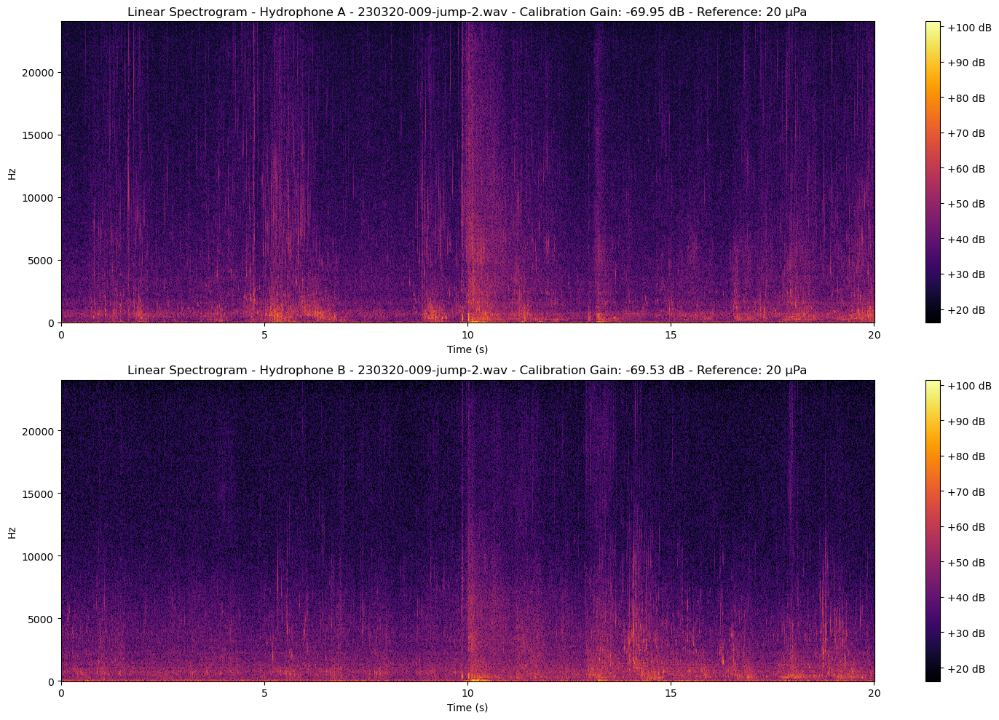

In [13]:
plt.figure(figsize=(15, 10))

# cmap should be in same range for both plots
cmap = 'inferno'
cmap_min = np.min([min_dB_A, min_dB_B])
cmap_max = np.max([max_dB_A, max_dB_B])

plt.subplot(2, 1, 1)
im = librosa.display.specshow(spectrogram_dB_A, sr=sr, hop_length=HOP_LENGTH, x_axis='time', y_axis='linear', cmap='inferno', vmin=cmap_min, vmax=cmap_max)
plt.colorbar(im, format='%+2.0f dB')
plt.title(f'Linear Spectrogram - Hydrophone A - {AUDIO_FILE} - Calibration Gain: {20 * np.log10(calibration_gain_A):.2f} dB - Reference: 20 \u03bcPa')
time_unit = 'min' if spectrogram_dB_A.shape[1] / sr * HOP_LENGTH > 60 else 's'
plt.xlabel(f'Time ({time_unit})')


plt.subplot(2, 1, 2)
im = librosa.display.specshow(spectrogram_dB_B, sr=sr, hop_length=HOP_LENGTH, x_axis='time', y_axis='linear', cmap='inferno', vmin=cmap_min, vmax=cmap_max)
plt.colorbar(im, format='%+2.0f dB')
plt.title(f'Linear Spectrogram - Hydrophone B - {AUDIO_FILE} - Calibration Gain: {20 * np.log10(calibration_gain_B):.2f} dB - Reference: 20 \u03bcPa')
time_unit = 'min' if spectrogram_dB_B.shape[1] / sr * HOP_LENGTH > 60 else 's'
plt.xlabel(f'Time ({time_unit})')

plt.tight_layout()

audio_file_name = AUDIO_FILE.replace('.wav', '')
plt.savefig(f'graphs/spectrogram-{audio_file_name}.png', dpi=300)
plt.show()

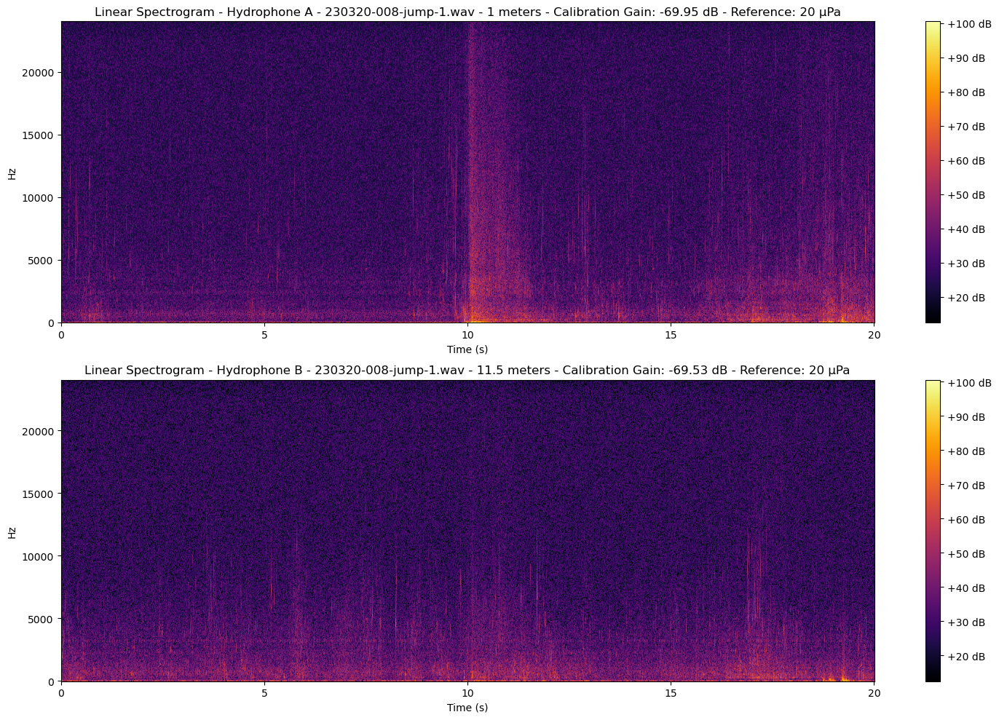

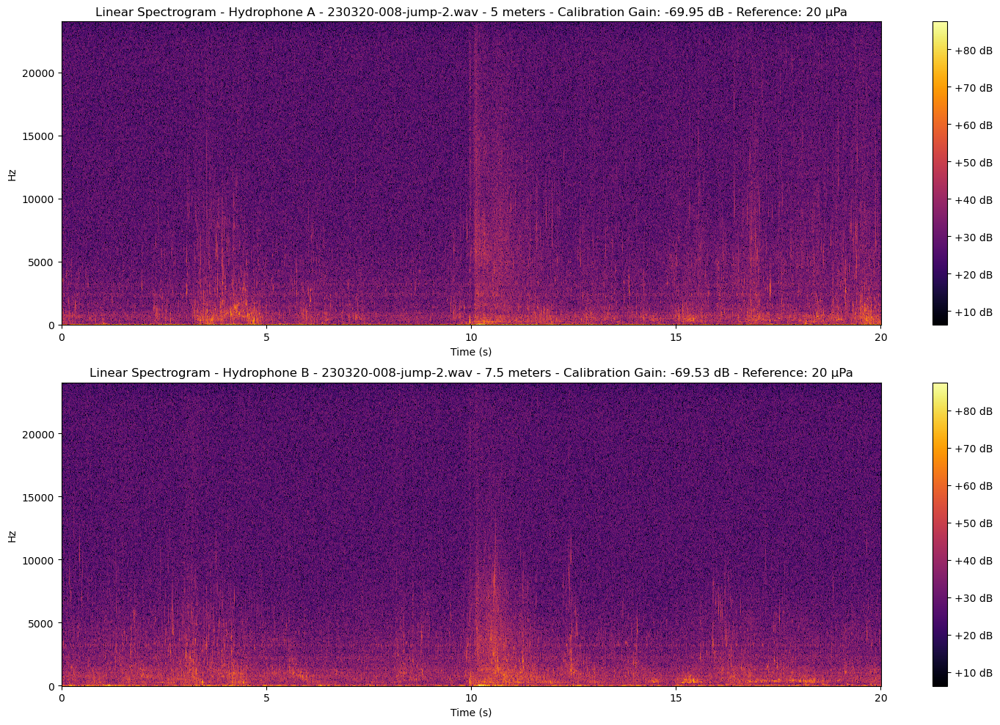

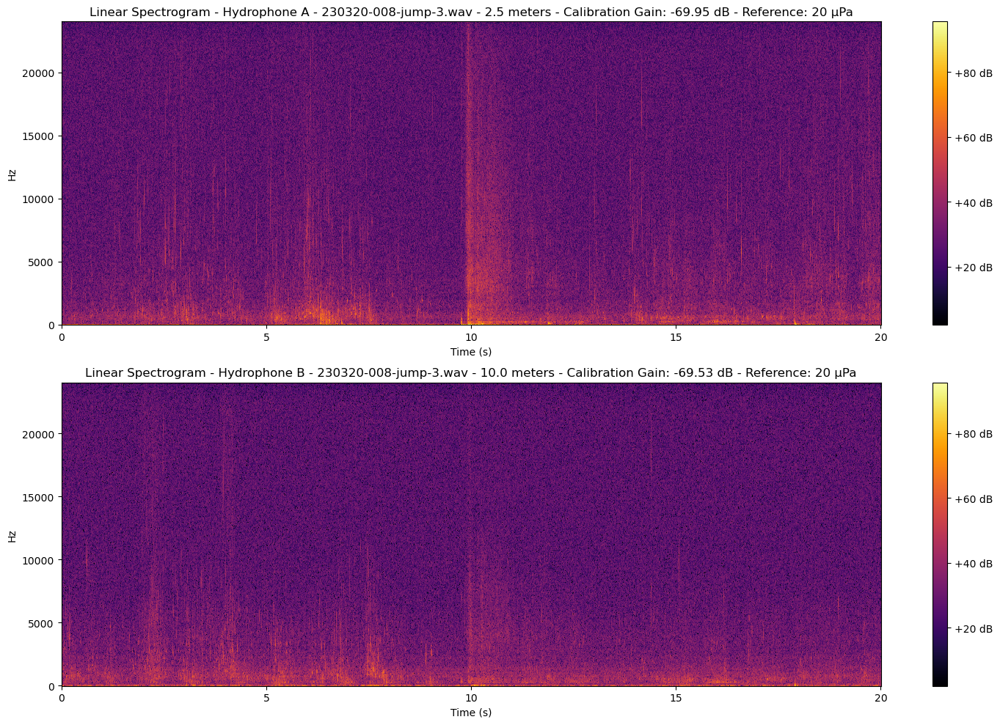

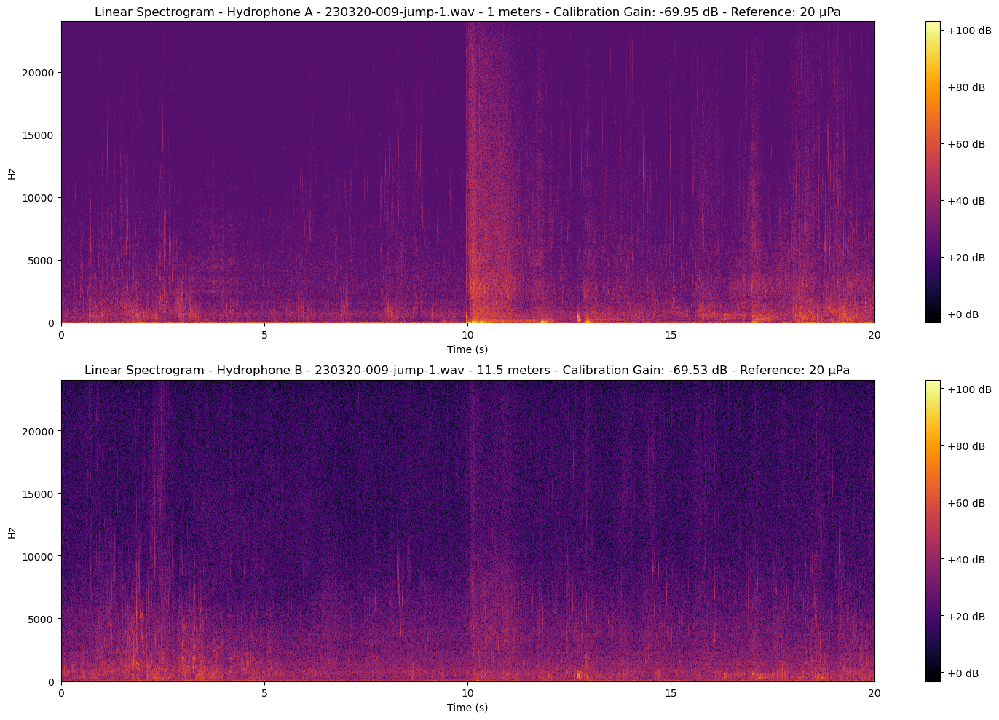

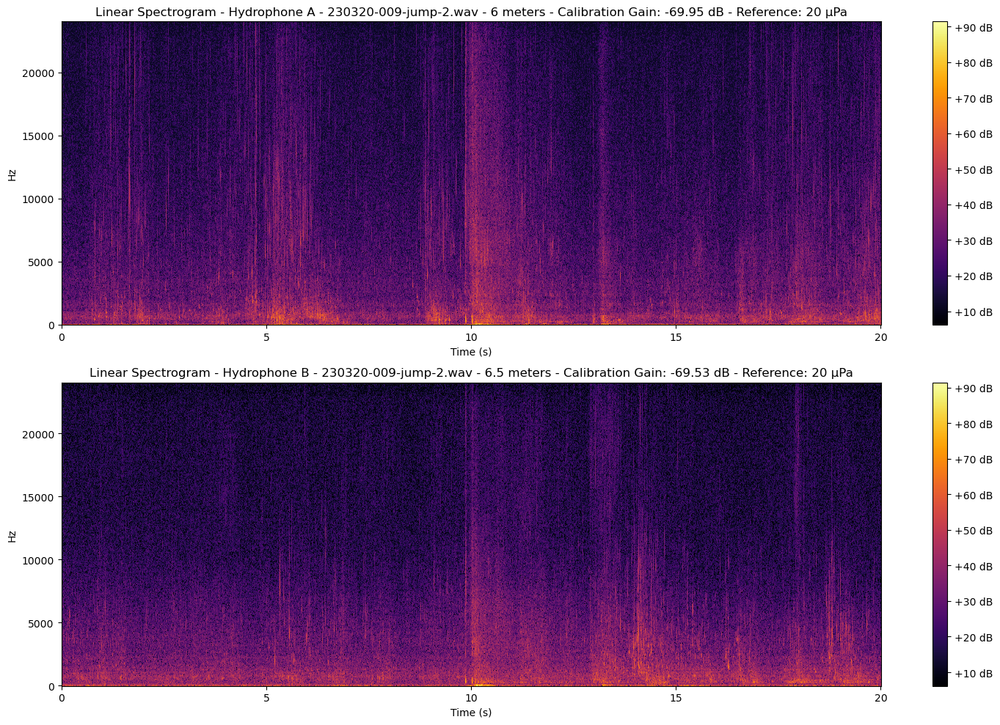

In [14]:
NFFT = 1024
HOP_LENGTH = 512
TOP_DB = 80
DISTANCE = 12.5

jump_files = list(sorted(os.listdir(AUDIO_BASEPATH)))
gains = [0, 0, 0, 20, 20]
distances = [1, 5, 2.5, 1, 6]
spectrograms = list()

for idx, (jump_file, gain) in enumerate(zip(jump_files, gains)):
    audio_path = os.path.join(AUDIO_BASEPATH, jump_file)
    
    calibration_path_A = os.path.join(CALIBRATION_BASEPATH, f'230320-010-calibration-A-{gain}dB.wav')
    calibration_path_B = os.path.join(CALIBRATION_BASEPATH, f'230320-011-calibration-B-{gain}dB.wav')
    
    audio, sr = librosa.load(audio_path, sr=None, mono=False)
    
    calibration_gain_A = calculate_calibration_gain(calibration_path_A, printing=False)
    calibration_gain_B = calculate_calibration_gain(calibration_path_B, printing=False)
    
    spectrogram = librosa.stft(audio, n_fft=NFFT, hop_length=HOP_LENGTH)
    spectrogram_dB = librosa.amplitude_to_db(np.abs(spectrogram), top_db=TOP_DB, ref=1)

    spectrogram_dB_A = librosa.amplitude_to_db(np.abs(spectrogram[0]), top_db=TOP_DB, ref=1) - 20 * np.log10(calibration_gain_A)
    spectrogram_dB_B = librosa.amplitude_to_db(np.abs(spectrogram[1]), top_db=TOP_DB, ref=1) - 20 * np.log10(calibration_gain_B)
    
    spectrograms.append((spectrogram_dB_A, spectrogram_dB_B))
    

for idx, (spectrogram_dB_A, spectrogram_dB_B) in enumerate(spectrograms):
    cmap_min = np.min([spectrogram_dB_A, spectrogram_dB_B])
    cmap_max = np.max([spectrogram_dB_A, spectrogram_dB_B])
    
    plt.figure(figsize=(15, 10))
    
    dist = distances[idx]
    plt.subplot(2, 1, 1)
    im = librosa.display.specshow(spectrogram_dB_A, sr=sr, hop_length=HOP_LENGTH, x_axis='time', y_axis='linear', cmap='inferno', vmin=cmap_min, vmax=cmap_max)
    plt.colorbar(im, format='%+2.0f dB')
    plt.title(f'Linear Spectrogram - Hydrophone A - {jump_files[idx]} - {dist} meters - Calibration Gain: {20 * np.log10(calibration_gain_A):.2f} dB - Reference: 20 \u03bcPa')
    time_unit = 'min' if spectrogram_dB_A.shape[1] / sr * HOP_LENGTH > 60 else 's'
    plt.xlabel(f'Time ({time_unit})')

    dist = DISTANCE - distances[idx]
    plt.subplot(2, 1, 2)
    im = librosa.display.specshow(spectrogram_dB_B, sr=sr, hop_length=HOP_LENGTH, x_axis='time', y_axis='linear', cmap='inferno', vmin=cmap_min, vmax=cmap_max)
    plt.colorbar(im, format='%+2.0f dB')
    plt.title(f'Linear Spectrogram - Hydrophone B - {jump_files[idx]} - {dist} meters - Calibration Gain: {20 * np.log10(calibration_gain_B):.2f} dB - Reference: 20 \u03bcPa')
    time_unit = 'min' if spectrogram_dB_B.shape[1] / sr * HOP_LENGTH > 60 else 's'
    plt.xlabel(f'Time ({time_unit})')

    plt.tight_layout()

    audio_file_name = jump_files[idx].replace('.wav', '')
    plt.savefig(f'graphs/spectrogram-{audio_file_name}.png', dpi=300)
    plt.show()

In [15]:
FRAME_SIZE = int(48000 * 0.125) # 125 ms (fast RMS)
HOP_LENGTH = FRAME_SIZE // 2

audio_rms = librosa.feature.rms(y=audio, frame_length=FRAME_SIZE, hop_length=HOP_LENGTH)

audio_spl_A = librosa.amplitude_to_db(audio_rms[0], ref=1).reshape(-1) - 20 * np.log10(calibration_gain_A)
audio_spl_B = librosa.amplitude_to_db(audio_rms[1], ref=1).reshape(-1) - 20 * np.log10(calibration_gain_B)

time = librosa.times_like(audio_spl_A, sr=sr, hop_length=HOP_LENGTH)

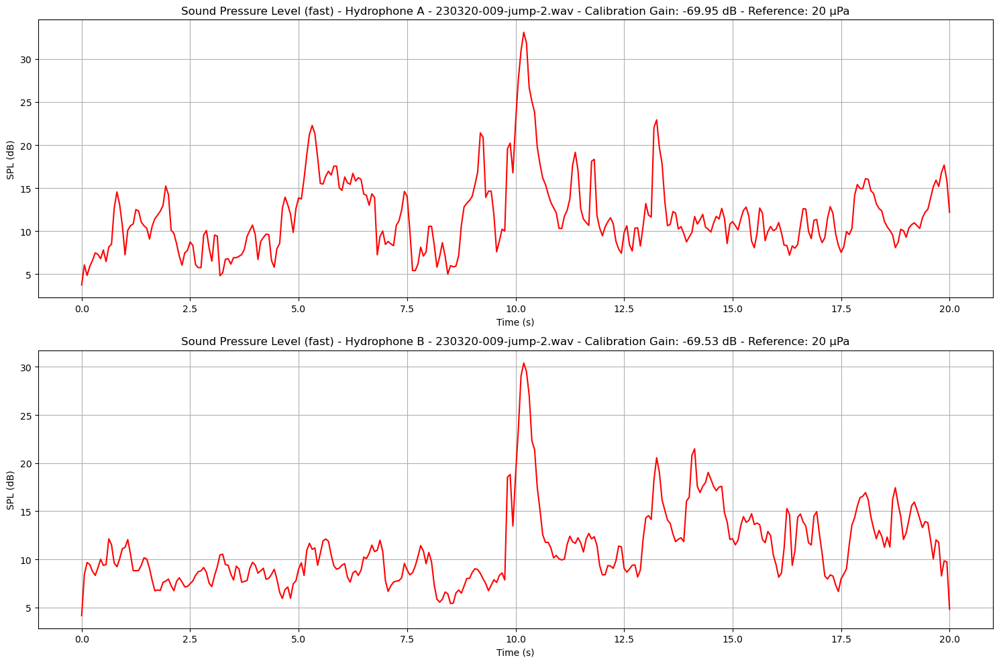

In [16]:
plt.figure(figsize=(15, 10))

plt.subplot(2, 1, 1)
plt.plot(time, audio_spl_A, color='red')
plt.title(f'Sound Pressure Level (fast) - Hydrophone A - {AUDIO_FILE} - Calibration Gain: {20 * np.log10(calibration_gain_A):.2f} dB - Reference: 20 \u03bcPa')
plt.xlabel('Time (s)')
plt.ylabel('SPL (dB)')
plt.grid()

plt.subplot(2, 1, 2)
plt.plot(time, audio_spl_B, color='red')
plt.title(f'Sound Pressure Level (fast) - Hydrophone B - {AUDIO_FILE} - Calibration Gain: {20 * np.log10(calibration_gain_B):.2f} dB - Reference: 20 \u03bcPa')
plt.xlabel('Time (s)')
plt.ylabel('SPL (dB)')
plt.grid()

plt.tight_layout()

audio_file_name = AUDIO_FILE.replace('.wav', '')
plt.savefig(f'graphs/spl-{audio_file_name}.png', dpi=300)
plt.show()

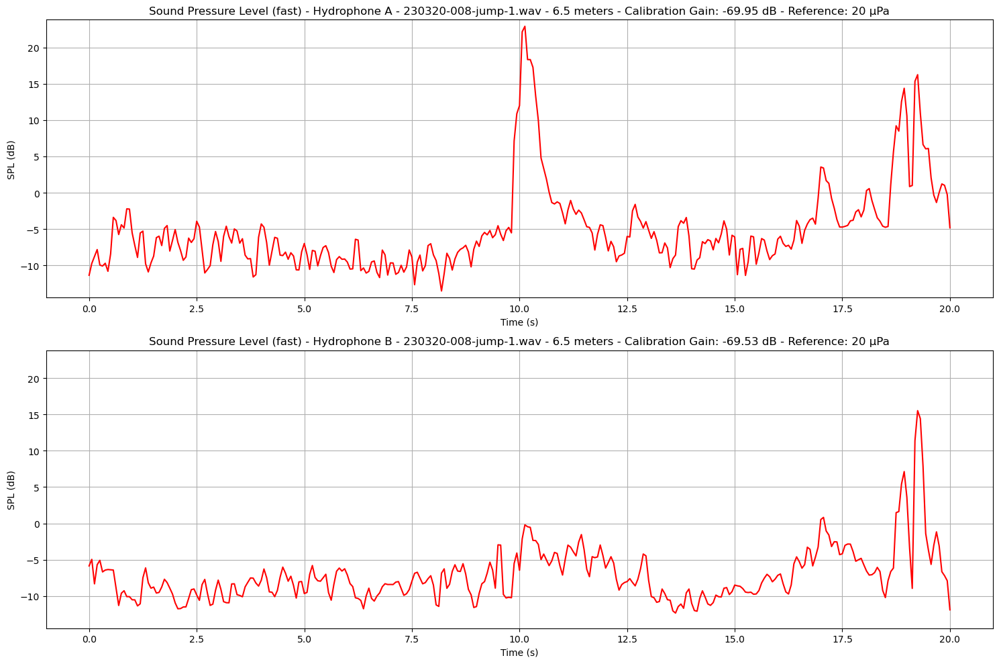

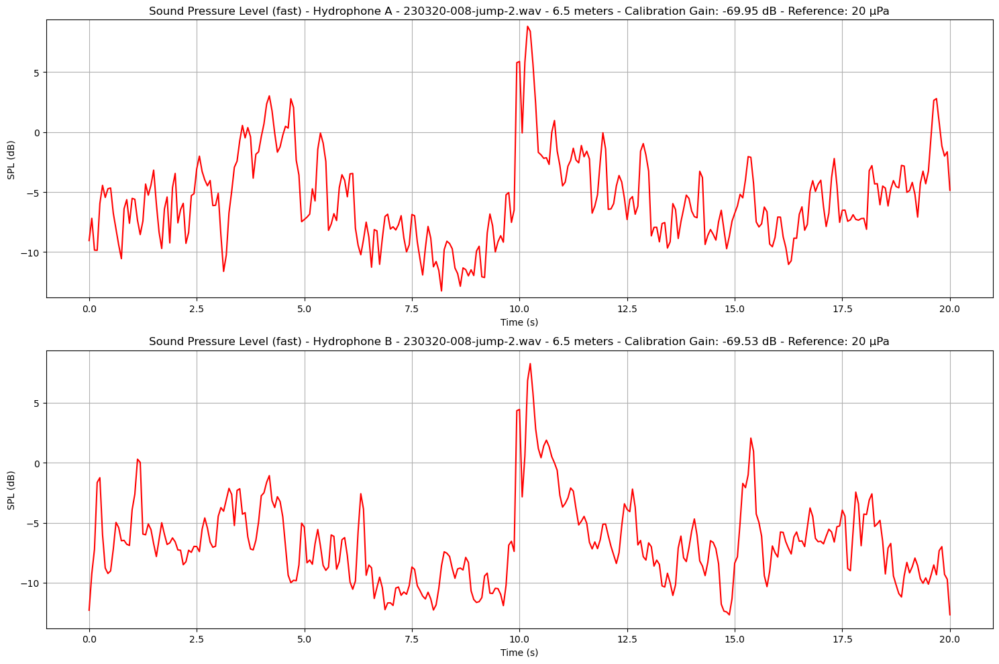

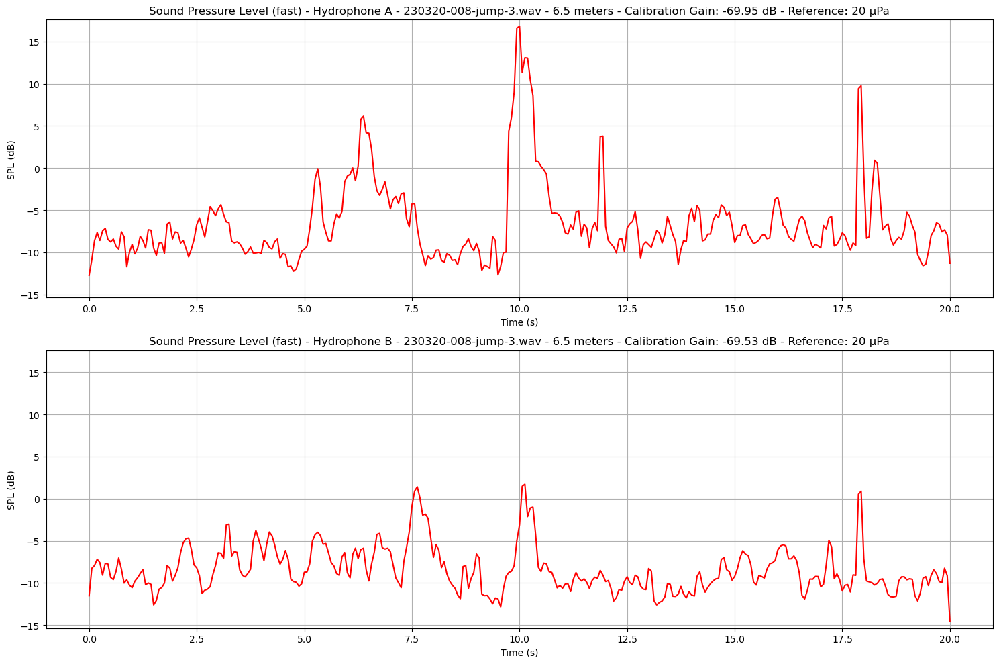

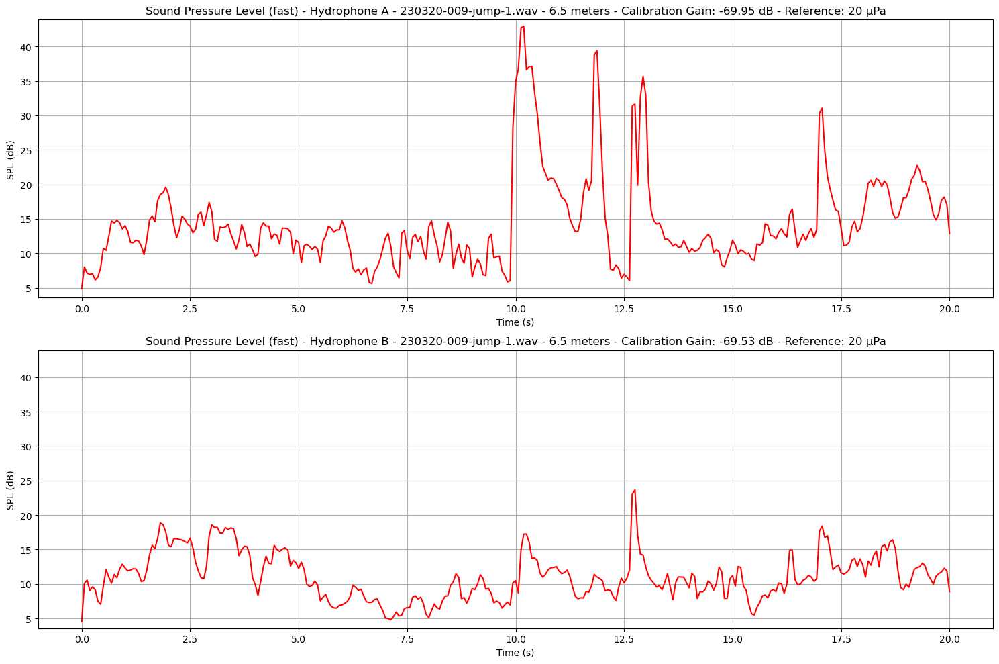

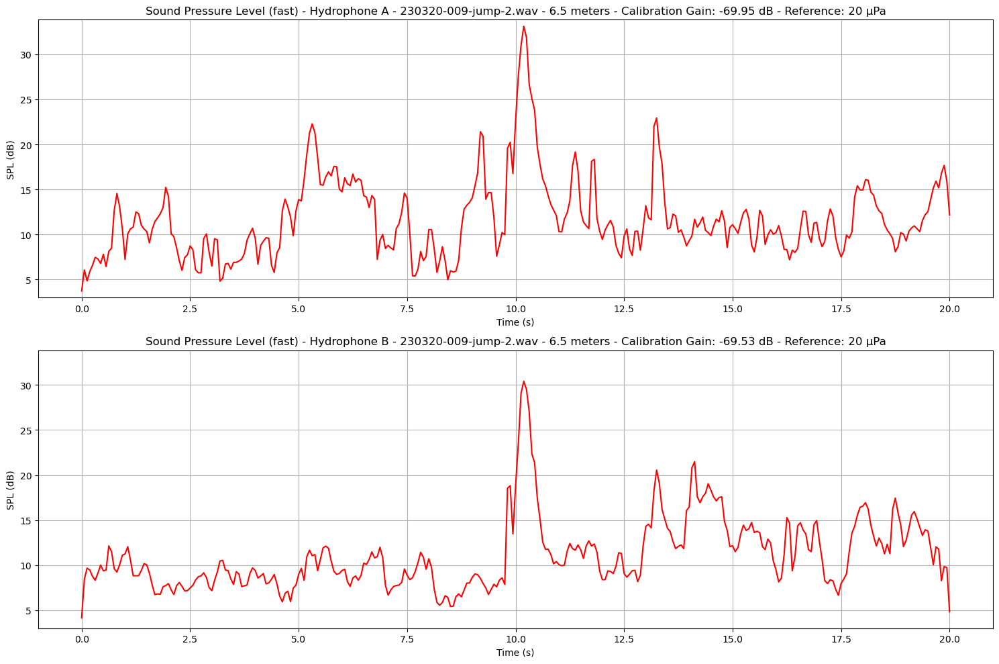

In [17]:
DISTANCE = 12.5
PADDING_Y = 1.05
JUMP_START, JUMP_END = 9.5, 11

jump_files = list(sorted(os.listdir(AUDIO_BASEPATH)))
gains = [0, 0, 0, 20, 20]
distances = [1, 5, 2.5, 1, 6]
spls = list()

for idx, (jump_file, gain) in enumerate(zip(jump_files, gains)):
    audio_path = os.path.join(AUDIO_BASEPATH, jump_file)
    
    calibration_path_A = os.path.join(CALIBRATION_BASEPATH, f'230320-010-calibration-A-{gain}dB.wav')
    calibration_path_B = os.path.join(CALIBRATION_BASEPATH, f'230320-011-calibration-B-{gain}dB.wav')
    
    audio, sr = librosa.load(audio_path, sr=None, mono=False)
    
    audio_rms = librosa.feature.rms(y=audio, frame_length=FRAME_SIZE, hop_length=HOP_LENGTH)

    audio_spl_A = librosa.amplitude_to_db(audio_rms[0], ref=1).reshape(-1) - 20 * np.log10(calibration_gain_A)
    audio_spl_B = librosa.amplitude_to_db(audio_rms[1], ref=1).reshape(-1) - 20 * np.log10(calibration_gain_B)

    time = librosa.times_like(audio_spl_A, sr=sr, hop_length=HOP_LENGTH)
    
    min_spl = np.min([audio_spl_A, audio_spl_B])
    max_spl = np.max([audio_spl_A, audio_spl_B])
    
    middle = (max_spl + min_spl) / 2
    
    min_spl = middle - (middle - min_spl) * PADDING_Y
    max_spl = middle + (max_spl - middle) * PADDING_Y

    plt.figure(figsize=(15, 10))
    
    plt.subplot(2, 1, 1)
    plt.plot(time, audio_spl_A, color='red')
    plt.title(f'Sound Pressure Level (fast) - Hydrophone A - {jump_file} - {dist} meters - Calibration Gain: {20 * np.log10(calibration_gain_A):.2f} dB - Reference: 20 \u03bcPa')
    plt.xlabel('Time (s)')
    plt.ylabel('SPL (dB)')
    plt.ylim(min_spl, max_spl)
    plt.grid()
    
    plt.subplot(2, 1, 2)
    plt.plot(time, audio_spl_B, color='red')
    plt.title(f'Sound Pressure Level (fast) - Hydrophone B - {jump_file} - {dist} meters - Calibration Gain: {20 * np.log10(calibration_gain_B):.2f} dB - Reference: 20 \u03bcPa')
    plt.xlabel('Time (s)')
    plt.ylabel('SPL (dB)')
    plt.ylim(min_spl, max_spl)
    plt.grid()

    plt.tight_layout()

    audio_file_name = jump_file.replace('.wav', '')
    plt.savefig(f'graphs/spl-{audio_file_name}.png', dpi=300)
    plt.show()

## 1 channel jumps

In [18]:
CALIBRATION_BASEPATH = 'data/measurment-2/calibrations/'
CALIBRATION_FILE = '230428-004-calibration-30dB.wav'

calibration_path = os.path.join(CALIBRATION_BASEPATH, CALIBRATION_FILE)

In [19]:
AUDIO_BASEPATH = 'data/measurment-2/jumps/'
AUDIO_FILE = '230428-003-jump-pad-1.wav'

audio_path = os.path.join(AUDIO_BASEPATH, AUDIO_FILE)

In [20]:
DISTANCES = [5, 10, 15, 20, 25, 30, 35, 40]

In [21]:
audio, sr = librosa.load(audio_path, sr=None, mono=False)
audio_1_channel = audio

length = audio.shape[0] / sr

print('Audio length: {:.2f} seconds'.format(length))
print('Sample rate: {} Hz'.format(sr))
print('Hydrophone')

Audio(audio, rate=sr)

Audio length: 20.00 seconds
Sample rate: 48000 Hz
Hydrophone


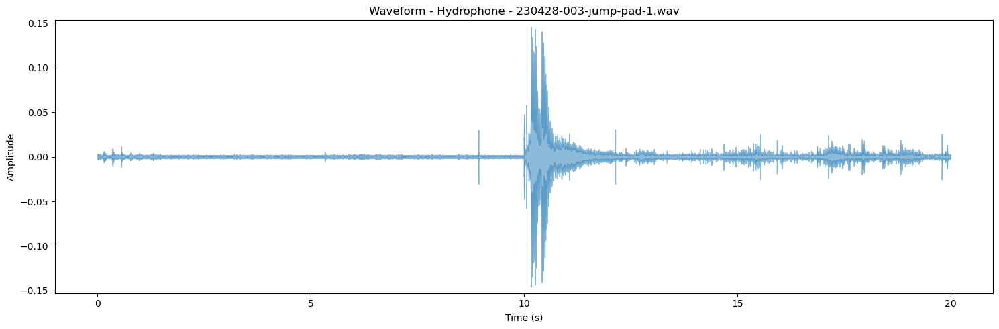

In [22]:
y_max = np.max(np.abs(audio_1_channel)) * 1.05

plt.figure(figsize=(15, 5))

librosa.display.waveshow(audio_1_channel, sr=sr, alpha=0.5)
plt.ylim(-y_max, y_max)
plt.title(f'Waveform - Hydrophone - {AUDIO_FILE}')
plt.ylabel('Amplitude')
time_unit = 'min' if audio_1_channel.shape[0] / sr > 60 else 's'
plt.xlabel(f'Time ({time_unit})')

plt.tight_layout()

plt.show()

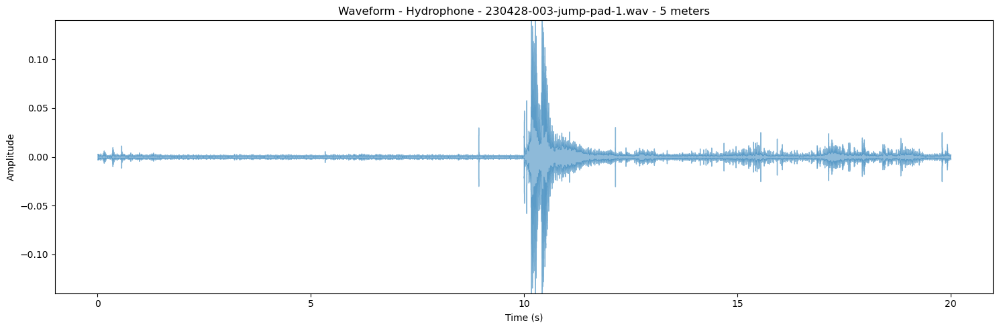

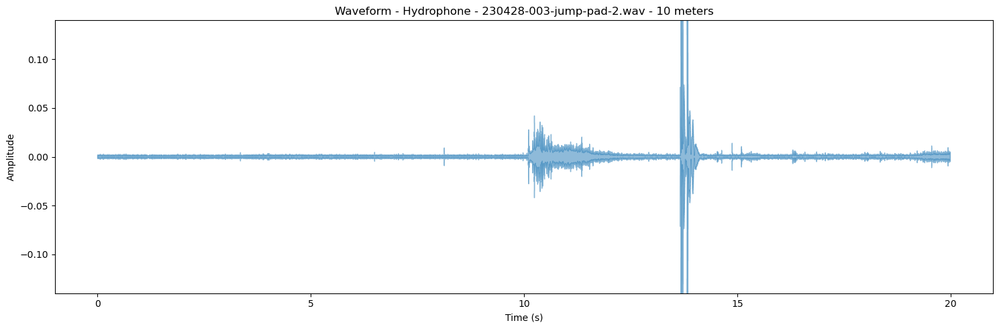

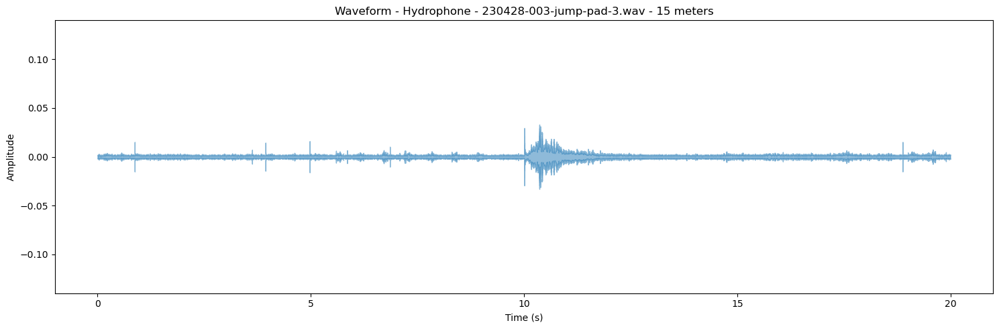

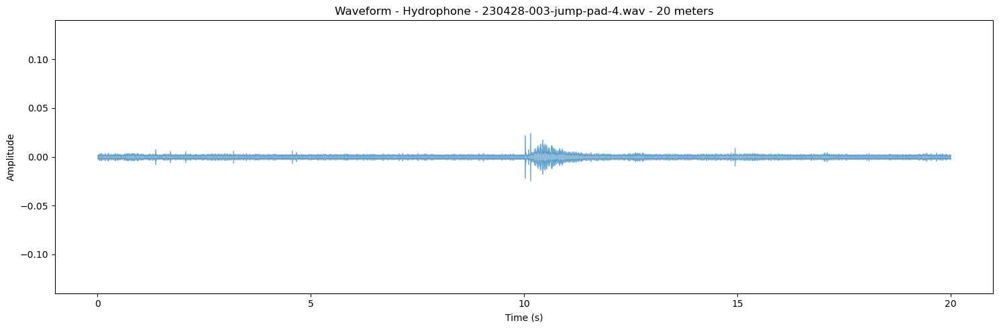

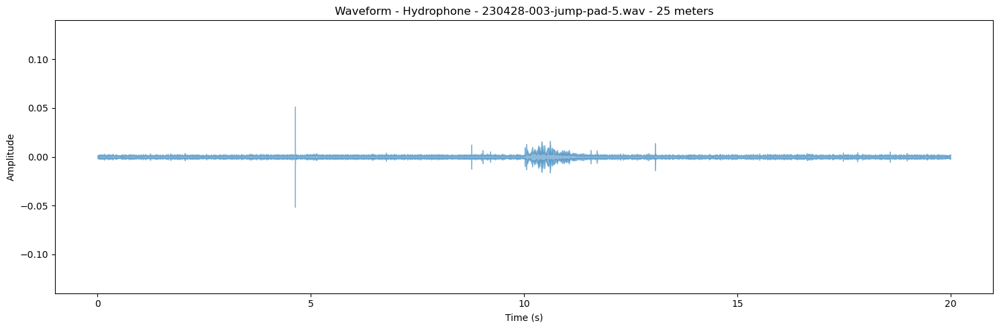

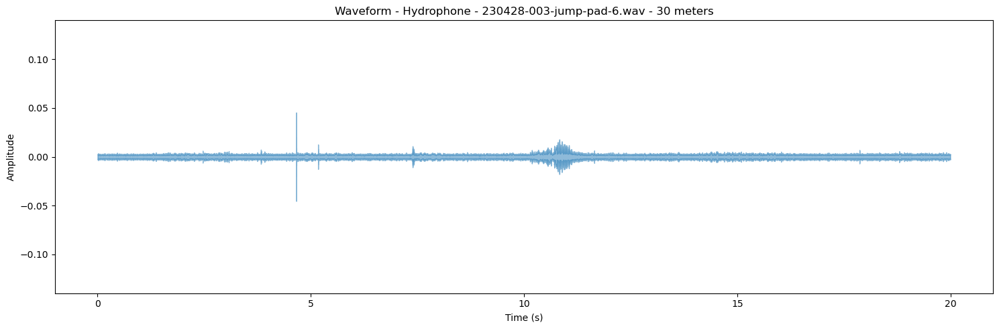

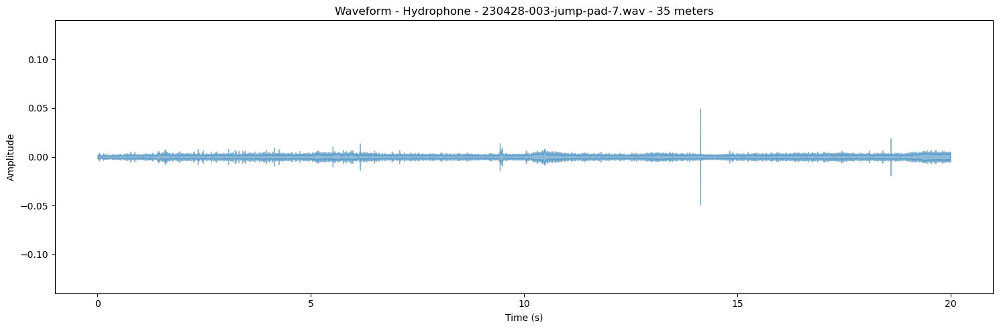

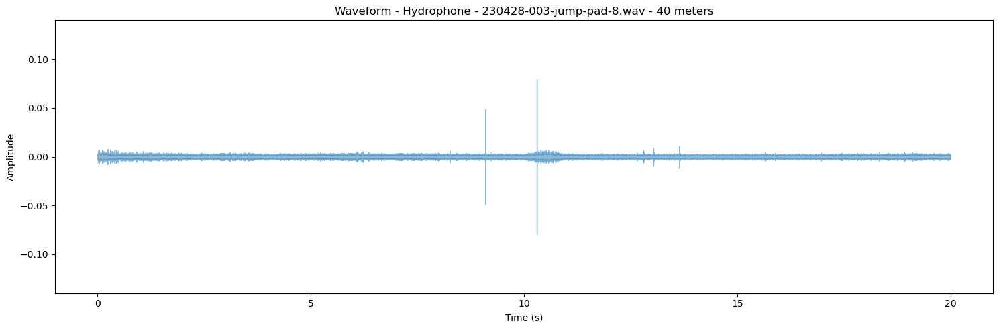

In [23]:
PADDING = True
Y_MAX = 0.14

if PADDING:
    jump_files = list(sorted(filter(lambda x: '-pad' in x, os.listdir(AUDIO_BASEPATH))))
else:
    jump_files = list(sorted(filter(lambda x: '-pad' not in x, os.listdir(AUDIO_BASEPATH))))

for idx, jump_file in enumerate(jump_files):
    audio_path = os.path.join(AUDIO_BASEPATH, jump_file)
    
    audio, sr = librosa.load(audio_path, sr=None, mono=False)

    plt.figure(figsize=(15, 5))

    librosa.display.waveshow(audio, sr=sr, alpha=0.5)
    plt.ylim(-Y_MAX, Y_MAX)
    plt.title(f'Waveform - Hydrophone - {jump_file} - {DISTANCES[idx]} meters')
    plt.ylabel('Amplitude')
    time_unit = 'min' if audio.shape[0] / sr  > 60 else 's'
    plt.xlabel(f'Time ({time_unit})')

    plt.tight_layout()
    
    jump_file = jump_file.replace('.wav', '')
    plt.savefig(f'graphs/waveform-{jump_file}-{DISTANCES[idx]}m.png', dpi=300)

In [24]:
calibration_gain = calculate_calibration_gain(calibration_path)

Calibration file: data/measurment-2/calibrations/230428-004-calibration-30dB.wav
Calibration length: 5.88 seconds
Calibration RMS: -9.76 dB (ref 1 Pa)
Calibration SPL: 64.22 dB (ref 20 uPa)
Calibration gain: -59.58 dB (0.0010497809295782082)



In [25]:
NFFT = 1024
HOP_LENGTH = 512
TOP_DB = 80

spectrogram = librosa.stft(audio_1_channel, n_fft=NFFT, hop_length=HOP_LENGTH)
spectrogram_dB = librosa.amplitude_to_db(np.abs(spectrogram), top_db=TOP_DB, ref=1)
# NOTE: what ref can be used here? (1, np.max, 2e-5, or what)

spectrogram_dB = librosa.amplitude_to_db(np.abs(spectrogram), top_db=TOP_DB, ref=1) - 20 * np.log10(calibration_gain)

In [26]:
min_dB, max_dB = np.min(spectrogram_dB), np.max(spectrogram_dB)

print(f'Hydrophone - Min: {min_dB:.2f} dB, Max: {max_dB:.2f} dB')

Hydrophone - Min: 12.94 dB, Max: 92.94 dB


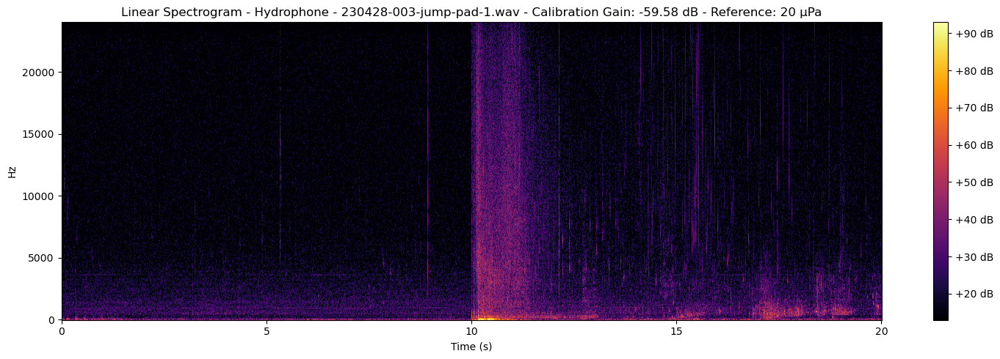

In [27]:
plt.figure(figsize=(15, 5))

im = librosa.display.specshow(spectrogram_dB, sr=sr, hop_length=HOP_LENGTH, x_axis='time', y_axis='linear', cmap='inferno')
plt.colorbar(im, format='%+2.0f dB')
plt.title(f'Linear Spectrogram - Hydrophone - {AUDIO_FILE} - Calibration Gain: {20 * np.log10(calibration_gain):.2f} dB - Reference: 20 \u03bcPa')
time_unit = 'min' if spectrogram_dB.shape[1] / sr * HOP_LENGTH > 60 else 's'
plt.xlabel(f'Time ({time_unit})')

plt.tight_layout()

plt.show()

Jump 1 - 230428-003-jump-pad-1.wav - Min: 12.94 dB, Max: 92.94 dB
Jump 2 - 230428-003-jump-pad-2.wav - Min: 16.98 dB, Max: 96.98 dB
Jump 3 - 230428-003-jump-pad-3.wav - Min: 1.09 dB, Max: 81.09 dB
Jump 4 - 230428-003-jump-pad-4.wav - Min: -4.39 dB, Max: 75.61 dB
Jump 5 - 230428-003-jump-pad-5.wav - Min: -4.87 dB, Max: 75.13 dB
Jump 6 - 230428-003-jump-pad-6.wav - Min: -4.71 dB, Max: 75.29 dB
Jump 7 - 230428-003-jump-pad-7.wav - Min: -12.55 dB, Max: 67.45 dB
Jump 8 - 230428-003-jump-pad-8.wav - Min: -14.44 dB, Max: 65.56 dB


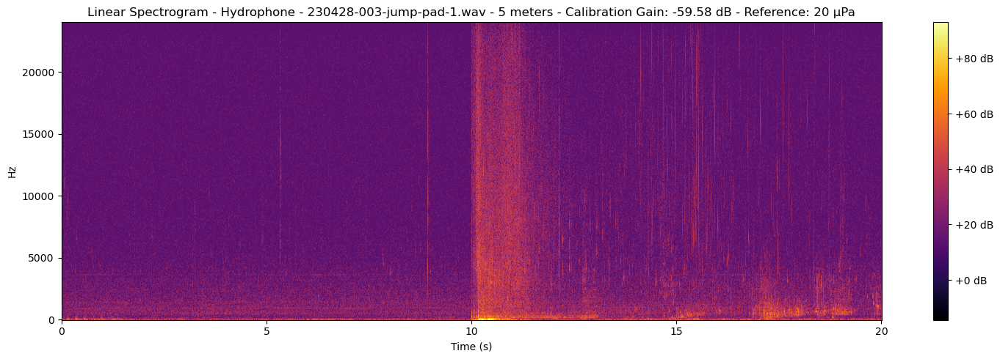

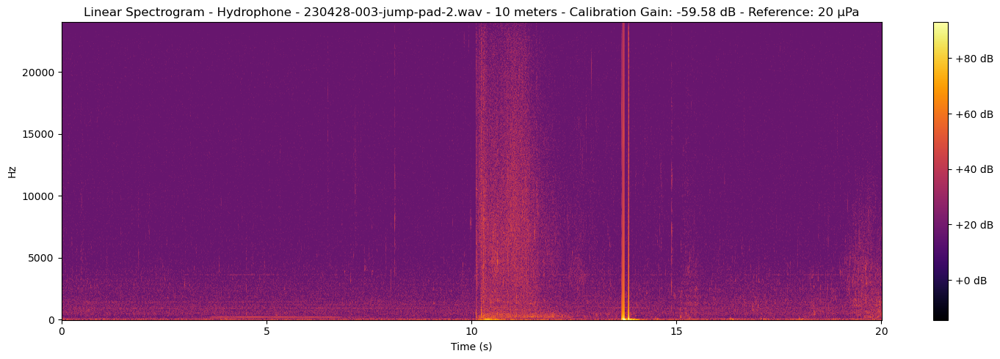

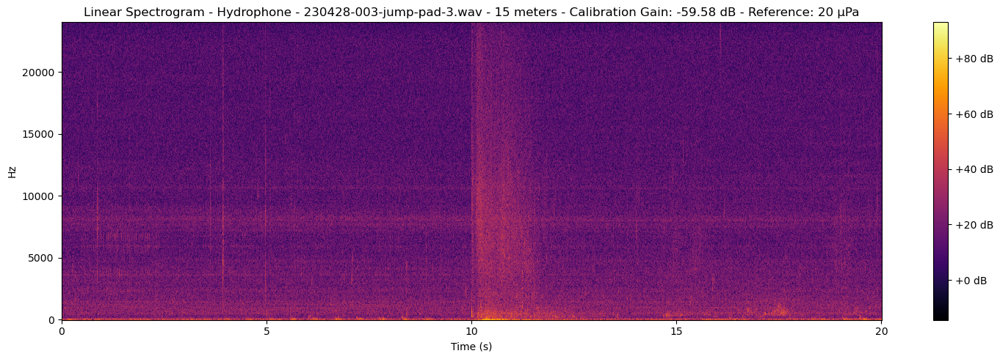

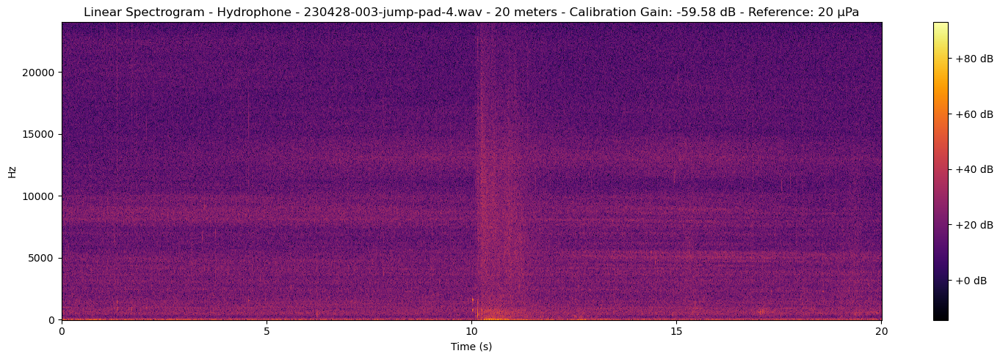

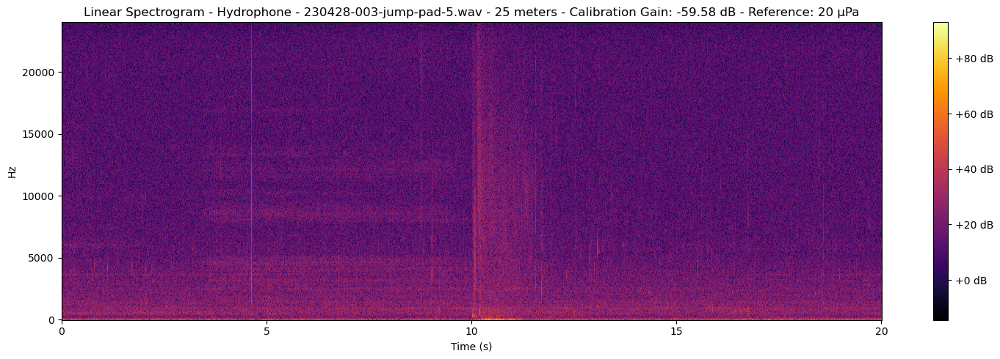

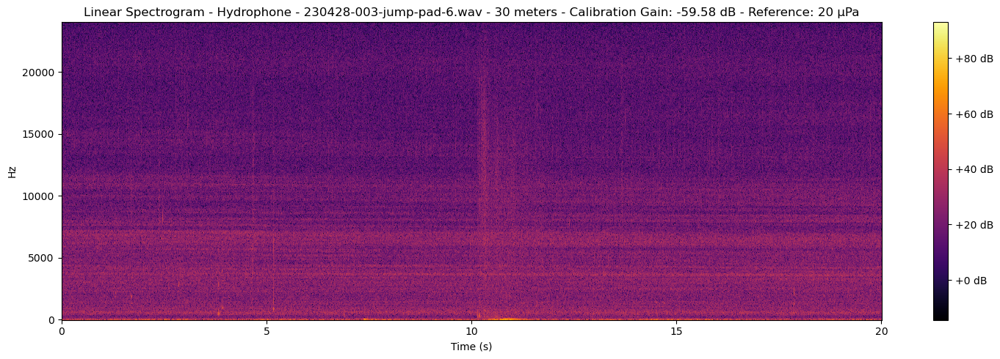

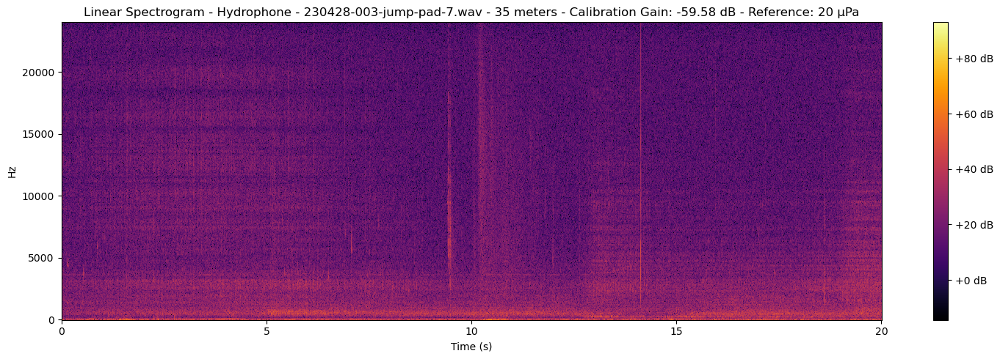

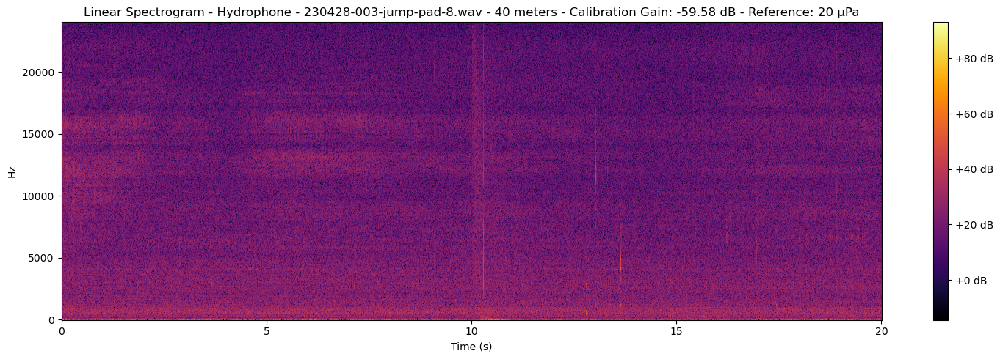

In [28]:
NFFT = 1024
HOP_LENGTH = 512
TOP_DB = 80
TYPE = 'linear' # 'log' or 'linear'
PADDING = True

if PADDING:
    jump_files = list(sorted(filter(lambda x: '-pad' in x, os.listdir(AUDIO_BASEPATH))))
else:
    jump_files = list(sorted(filter(lambda x: '-pad' not in x, os.listdir(AUDIO_BASEPATH))))
spectrograms = list()

for idx, jump_file in enumerate(jump_files):
    audio_path = os.path.join(AUDIO_BASEPATH, jump_file)
    
    audio, sr = librosa.load(audio_path, sr=None, mono=False)
    length = audio.shape[0] / sr
    
    spectrogram = librosa.stft(audio, n_fft=NFFT, hop_length=HOP_LENGTH)
    spectrogram_dB = librosa.amplitude_to_db(np.abs(spectrogram), top_db=TOP_DB, ref=1) - 20 * np.log10(calibration_gain)
    
    print(f'Jump {idx + 1} - {jump_file} - Min: {np.min(spectrogram_dB):.2f} dB, Max: {np.max(spectrogram_dB):.2f} dB')
    
    spectrograms.append(spectrogram_dB)

cmap_min, cmap_max = np.min(spectrograms[-1]), np.max(spectrograms[0])


for idx, spectrogram_dB in enumerate(spectrograms):
    plt.figure(figsize=(15, 5))
    
    im = librosa.display.specshow(spectrogram_dB, sr=sr, hop_length=HOP_LENGTH, x_axis='time', y_axis=TYPE, cmap='inferno', vmin=cmap_min, vmax=cmap_max)
    plt.colorbar(im, format='%+2.0f dB')
    plt.title(f'{TYPE.capitalize()} Spectrogram - Hydrophone - {jump_files[idx]} - {DISTANCES[idx]} meters - Calibration Gain: {20 * np.log10(calibration_gain):.2f} dB - Reference: 20 \u03bcPa')
    time_unit = 'min' if spectrogram_dB.shape[1] / sr * HOP_LENGTH > 60 else 's'
    plt.xlabel(f'Time ({time_unit})')

    plt.tight_layout()
    
    jump_file = jump_files[idx].replace('.wav', '')
    plt.savefig(f'graphs/spectrogram-{jump_file}-{DISTANCES[idx]}m.png', dpi=300)

In [29]:
FRAME_SIZE = int(48000 * 0.125) # 125 ms (fast RMS)
HOP_LENGTH = FRAME_SIZE // 2

audio_rms = librosa.feature.rms(y=audio_1_channel, frame_length=FRAME_SIZE, hop_length=HOP_LENGTH)
audio_spl = librosa.amplitude_to_db(audio_rms, ref=1).reshape(-1) - 20 * np.log10(calibration_gain)
time = librosa.times_like(audio_spl, sr=sr, hop_length=HOP_LENGTH)

In [30]:
NOISE_START, NOISE_END = 2.3, 9.5
SIGNAL_START, SIGNAL_END = 10.1, 10.6

count = audio_rms.shape[1]
length = np.max(time)

N = np.mean(audio_rms[0, int(count*NOISE_START/length):int(count*NOISE_END/length)])
S = np.mean(audio_rms[0, int(count*SIGNAL_START/length):int(count*SIGNAL_END/length)])

SNR = 20 * np.log10(S / N)

print(f'SNR: {SNR:.2f} dB')

SNR: 38.35 dB


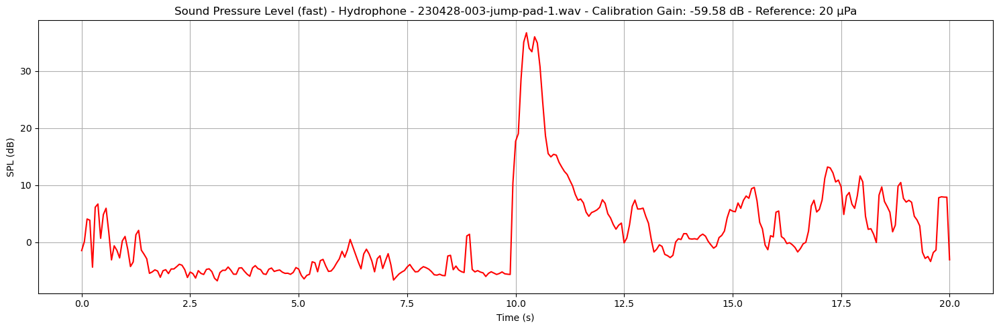

In [31]:
plt.figure(figsize=(15, 5))

plt.plot(time, audio_spl, color='red')
plt.title(f'Sound Pressure Level (fast) - Hydrophone - {AUDIO_FILE} - Calibration Gain: {20 * np.log10(calibration_gain):.2f} dB - Reference: 20 \u03bcPa')
plt.xlabel('Time (s)')
plt.ylabel('SPL (dB)')
plt.grid()

plt.tight_layout()

plt.show()

230428-003-jump-pad-1.wav - Max SPL: 36.68 dB at 10.25 seconds
230428-003-jump-pad-2.wav - Max SPL: 23.00 dB at 10.38 seconds
230428-003-jump-pad-3.wav - Max SPL: 22.85 dB at 10.38 seconds
230428-003-jump-pad-4.wav - Max SPL: 16.02 dB at 10.44 seconds
230428-003-jump-pad-5.wav - Max SPL: 15.61 dB at 10.38 seconds
230428-003-jump-pad-6.wav - Max SPL: 17.65 dB at 10.88 seconds
230428-003-jump-pad-7.wav - Max SPL: 9.38 dB at 10.44 seconds
230428-003-jump-pad-8.wav - Max SPL: 9.18 dB at 10.31 seconds


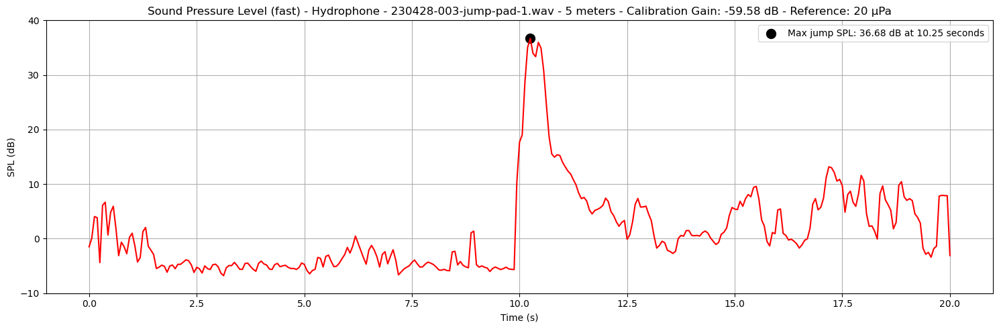

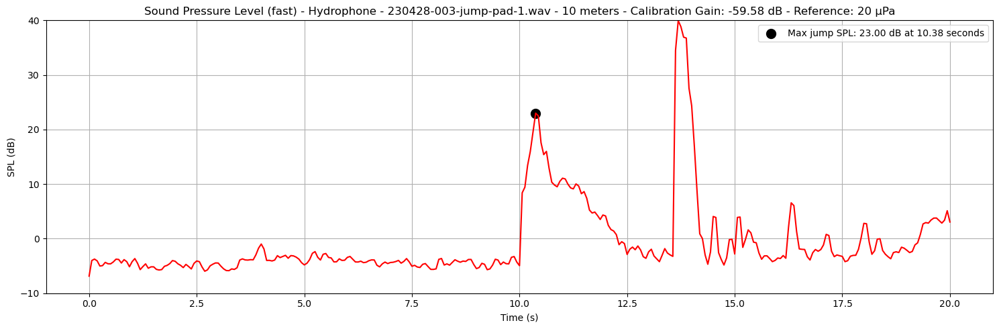

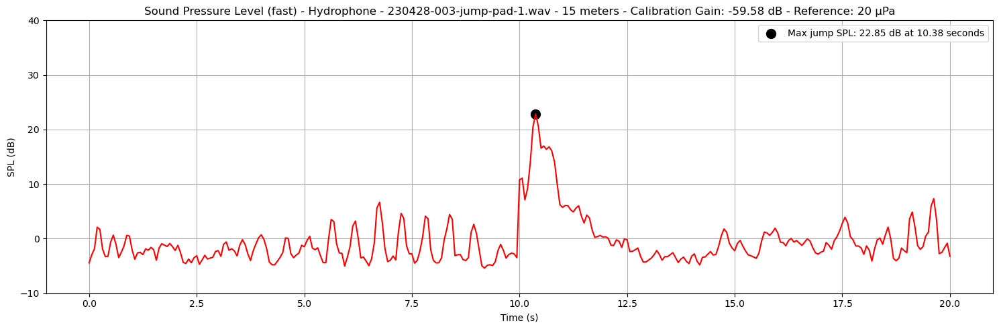

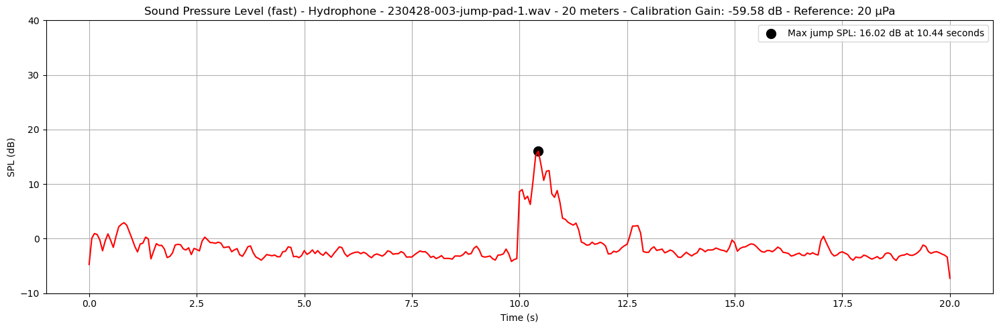

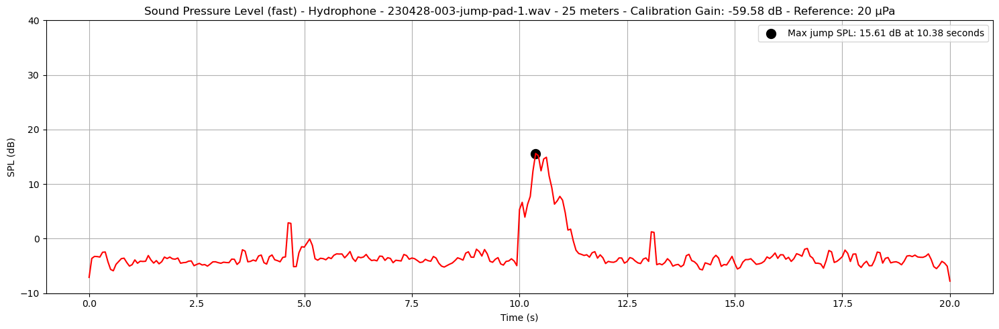

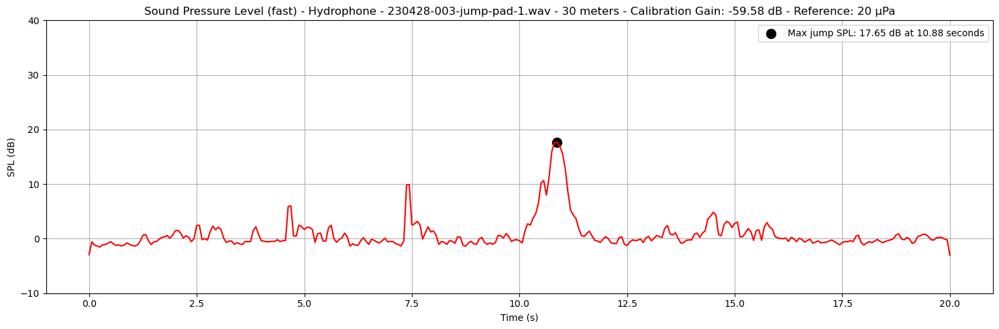

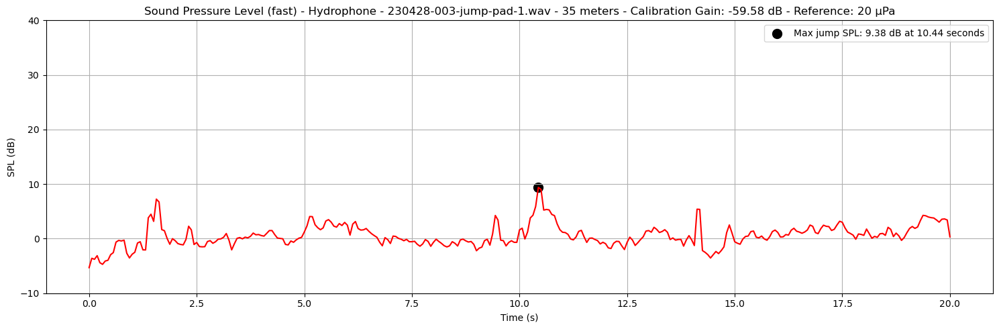

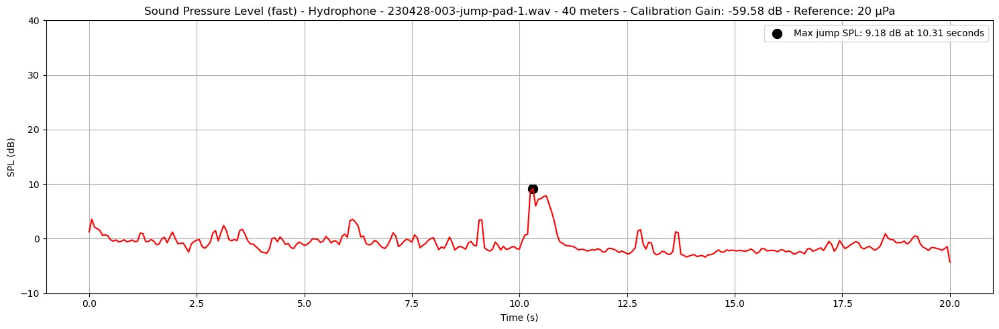

In [32]:
FRAME_SIZE = int(48000 * 0.125) # 125 ms (fast RMS)
HOP_LENGTH = FRAME_SIZE // 2
PADDING = True
JUMP_START, JUMP_END = 9.5, 12.5
Y_MIN, Y_MAX = -10, 40

if PADDING:
    jump_files = list(sorted(filter(lambda x: '-pad' in x, os.listdir(AUDIO_BASEPATH))))
else:
    jump_files = list(sorted(filter(lambda x: '-pad' not in x, os.listdir(AUDIO_BASEPATH))))

max_sples = list()

for idx, jump_file in enumerate(jump_files):
    audio_path = os.path.join(AUDIO_BASEPATH, jump_file)
    
    audio, sr = librosa.load(audio_path, sr=None, mono=False)
    length = audio.shape[0] / sr
    
    audio_rms = librosa.feature.rms(y=audio, frame_length=FRAME_SIZE, hop_length=HOP_LENGTH)
    audio_spl = librosa.amplitude_to_db(audio_rms, ref=1).reshape(-1) - 20 * np.log10(calibration_gain)
    time = librosa.times_like(audio_spl, sr=sr, hop_length=HOP_LENGTH)
    
    max_spl = np.max(audio_spl[int(JUMP_START * sr / HOP_LENGTH):int(JUMP_END * sr / HOP_LENGTH)])
    max_spl_pos = np.where(audio_spl == max_spl)[0][0]
    max_sples.append(max_spl)
    
    print(f'{jump_file} - Max SPL: {max_spl:.2f} dB at {time[max_spl_pos]:.2f} seconds')
    
    plt.figure(figsize=(15, 5))

    plt.plot(time, audio_spl, color='red')
    plt.title(f'Sound Pressure Level (fast) - Hydrophone - {AUDIO_FILE} - {DISTANCES[idx]} meters - Calibration Gain: {20 * np.log10(calibration_gain):.2f} dB - Reference: 20 \u03bcPa')
    plt.scatter(time[max_spl_pos], max_spl, color='black', marker='o', s=100, label=f'Max jump SPL: {max_spl:.2f} dB at {time[max_spl_pos]:.2f} seconds')
    plt.ylim(Y_MIN, Y_MAX)
    plt.xlabel('Time (s)')
    plt.ylabel('SPL (dB)')
    plt.legend()
    plt.grid()

    plt.tight_layout()
    
    jump_file = jump_file.replace('.wav', '')
    plt.savefig(f'graphs/spl-{jump_file}-{DISTANCES[idx]}m.png', dpi=300)

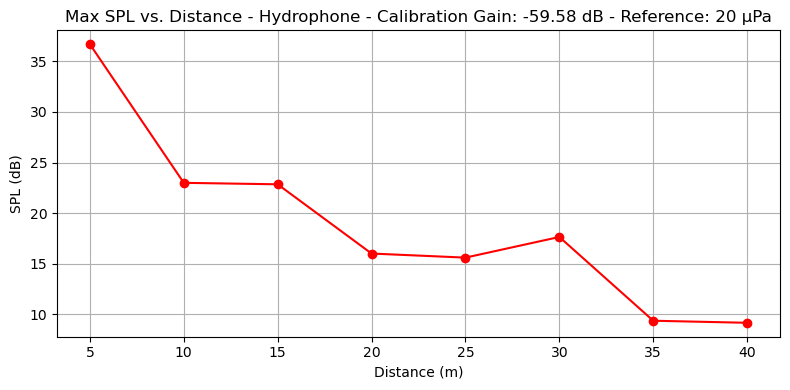

In [33]:
plt.figure(figsize=(8, 4))

plt.plot(DISTANCES, max_sples, color='red', marker='o')
plt.title(f'Max SPL vs. Distance - Hydrophone - Calibration Gain: {20 * np.log10(calibration_gain):.2f} dB - Reference: 20 \u03bcPa')
plt.xlabel('Distance (m)')
plt.ylabel('SPL (dB)')
plt.grid()

plt.tight_layout()

plt.savefig(f'graphs/spl-distance.png', dpi=300)
plt.show()

## Frequency analysis

In [34]:
SPECTRUM_FOLDER_PATH = 'data/measurment-2/spectrums/'
SPECTRUM_FILE = 'jump.txt'

spectrum_file_path = os.path.join(SPECTRUM_FOLDER_PATH, SPECTRUM_FILE)

In [35]:
spectrum = np.loadtxt(spectrum_file_path, skiprows=1, delimiter='\t')

print(f'Spectrum file: {spectrum_file_path}')
print(f'Spectrum shape: {spectrum.shape}')
print(f'Spectrum min: {np.min(spectrum[:, 1]):.2f} dB, max: {np.max(spectrum[:, 1]):.2f} dB')
print(f'Spectrum min freq: {np.min(spectrum[:, 0]):.2f} Hz, max freq: {np.max(spectrum[:, 0]):.2f} Hz')

Spectrum file: data/measurment-2/spectrums/jump.txt
Spectrum shape: (511, 2)
Spectrum min: -86.30 dB, max: -30.92 dB
Spectrum min freq: 46.88 Hz, max freq: 23953.12 Hz


In [36]:
REF_EFF = 20e-5 # Pa

In [37]:
x = spectrum[:, 0]
y = spectrum[:, 1]

y = 10 ** (y / 20)
y = 20 * np.log10(y / REF_EFF) #- 20 * np.log10(calibration_gain)

x_y = interp1d(x, y, kind = "cubic")

x_new = np.linspace(x.min(), x.max(), 10000)
y_new = x_y(x_new)

def tick_formatter(x):
    if x < 1000:
        return f'{x:.0f}'
    elif x < 1000000:
        return f'{x / 1000:.0f}k'
    else:
        return f'{x / 1000000:.0f}M'

x_log_ticks = [10, 20, 50, 100, 200, 500, 1000, 2000, 5000, 10000, 20000, 50000]
x_log_ticks = list(filter(lambda x: x >= x_new.min() and x <= x_new.max(), x_log_ticks))
x_log_ticks_labels = [tick_formatter(x_new) for x_new in x_log_ticks]

y_min = np.min(y)
y1 = np.ones(len(x_new)) * y_min
y2 = y_new

peaks, _ = signal.find_peaks(y_new)
peaks = peaks[:5]

x_peaks = x_new[peaks]
y_peaks = y_new[peaks]

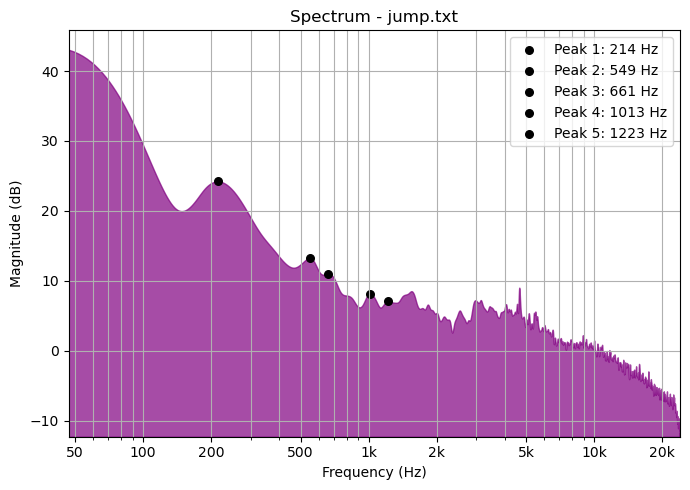

In [38]:
plt.figure(figsize=(7, 5))

plt.fill_between(x_new, y1, y2, color='purple', alpha=0.7)

for idx, (x_peak, y_peak) in enumerate(zip(x_peaks, y_peaks)):
    plt.scatter(x_peak, y_peak, color='black', marker='o', s=30, label=f'Peak {idx + 1}: {x_peak:.0f} Hz')

plt.title(f'Spectrum - {SPECTRUM_FILE}')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Magnitude (dB)')
plt.legend()
plt.grid(which='both')

plt.xlim(left=x_new.min(), right=x_new.max())
plt.xscale('log')
plt.xticks(x_log_ticks, x_log_ticks_labels)

plt.ylim(bottom=y_min)

plt.tight_layout()

plt.show()

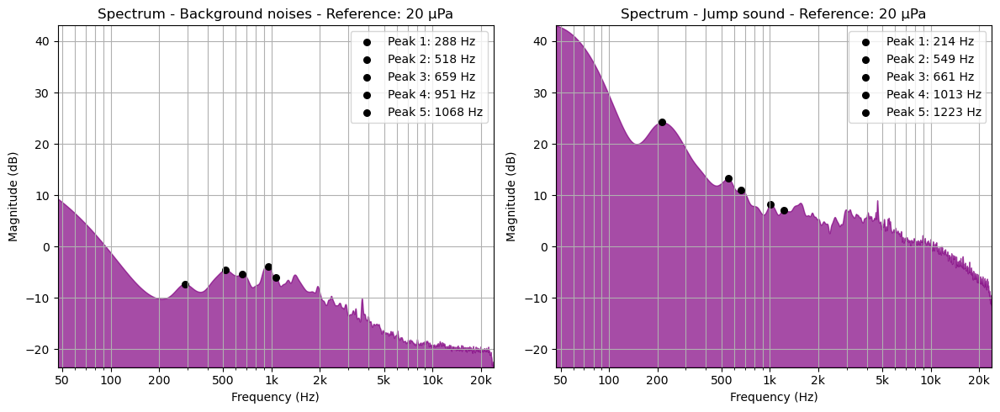

In [39]:
spectrum_files = ['background.txt', 'jump.txt']
spectrum_names = ['Background noises', 'Jump sound']
spectrums = list()

for idx, spectrum_file in enumerate(spectrum_files):
    spectrum_file_path = os.path.join(SPECTRUM_FOLDER_PATH, spectrum_file)
    spectrum = np.loadtxt(spectrum_file_path, skiprows=1, delimiter='\t')
    
    x = spectrum[:, 0]
    y = spectrum[:, 1]
    
    y = 10 ** (y / 20)
    y = 20 * np.log10(y / REF_EFF) #- 20 * np.log10(calibration_gain)

    x_y = interp1d(x, y, kind = "cubic")

    x_new = np.linspace(x.min(), x.max(), 10000)
    y_new = x_y(x_new)
    
    x_log_ticks = [10, 20, 50, 100, 200, 500, 1000, 2000, 5000, 10000, 20000, 50000]
    x_log_ticks = list(filter(lambda x: x >= x_new.min() and x <= x_new.max(), x_log_ticks))
    x_log_ticks_labels = [tick_formatter(x_new) for x_new in x_log_ticks]

    y_min = np.min(y)
    y1 = np.ones(len(x_new)) * y_min
    y2 = y_new

    peaks, _ = signal.find_peaks(y_new)
    peaks = peaks[:5]

    x_peaks = x_new[peaks]
    y_peaks = y_new[peaks]
    
    spectrums.append((x_new, y_new, x_log_ticks, x_log_ticks_labels, x_peaks, y_peaks))

y_min = np.min([np.min(spectrum[1]) for spectrum in spectrums])
y_max = np.max([np.max(spectrum[1]) for spectrum in spectrums])

fig, axs = plt.subplots(1, 2, figsize=(12, 5))

for idx, (spectrum_name, spectrum) in enumerate(zip(spectrum_names, spectrums)):
    x_new, y_new, x_log_ticks, x_log_ticks_labels, x_peaks, y_peaks = spectrum
    
    y1 = np.ones(len(x_new)) * y_min
    y2 = y_new
    
    axs[idx].fill_between(x_new, y1, y2, color='purple', alpha=0.7)
    
    for i, (x_peak, y_peak) in enumerate(zip(x_peaks, y_peaks)):
        axs[idx].scatter(x_peak, y_peak, color='black', marker='o', s=30, label=f'Peak {i + 1}: {x_peak:.0f} Hz')
        
    axs[idx].set_title(f'Spectrum - {spectrum_name} - Reference: 20 \u03bcPa')
    axs[idx].set_xlabel('Frequency (Hz)')
    axs[idx].set_ylabel('Magnitude (dB)')
    axs[idx].legend()
    axs[idx].grid(which='both')
    
    axs[idx].set_xlim(left=x_new.min(), right=x_new.max())
    axs[idx].set_xscale('log')
    axs[idx].set_xticks(x_log_ticks)
    axs[idx].set_xticklabels(x_log_ticks_labels)
    
    axs[idx].set_ylim(bottom=y_min, top=y_max)
    
plt.tight_layout()

plt.savefig(f'graphs/spectrum-comparison.png', dpi=300)
plt.show()

## Histogram of spectrograms

Max found dB for A =  91.4192 Max found dB for B =  86.14727
Min found dB for A =  11.419197 Min found dB for B =  6.14727


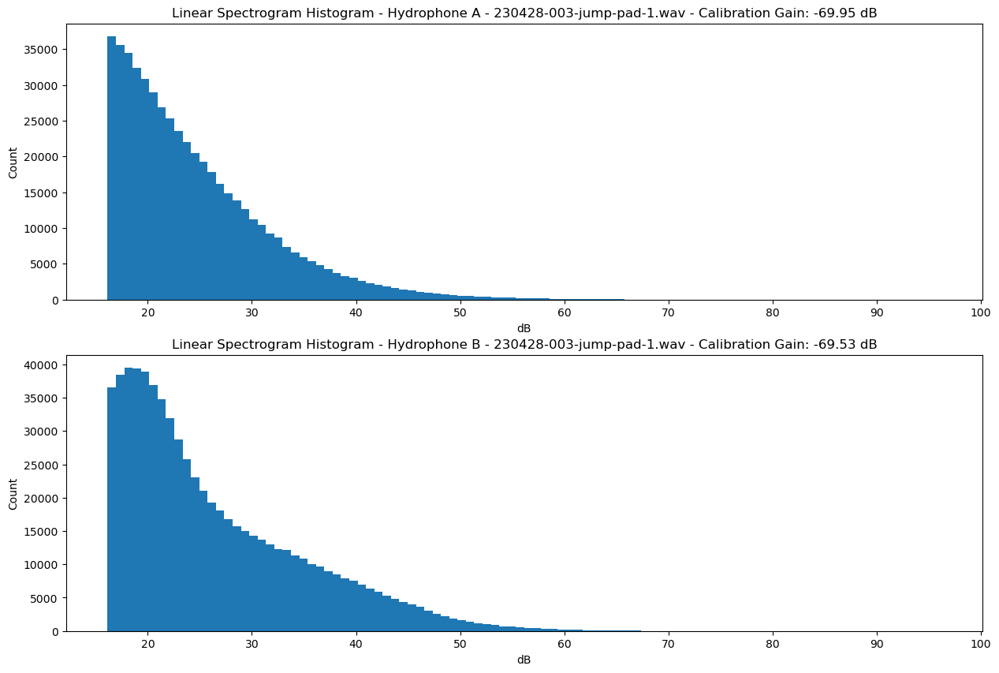

In [40]:
print("Max found dB for A = ", np.max(spectrogram_dB_A), "Max found dB for B = ", np.max(spectrogram_dB_B))
print("Min found dB for A = ", np.min(spectrogram_dB_A), "Min found dB for B = ", np.min(spectrogram_dB_B))

# Convert spectrogram for hydrohpone A and B to histogram
# We are only interested in the DB values, not the time axis or frequency axis:
histogram_A, bins = np.histogram(spectrogram_dB_A, bins=100, range=(min_dB_A, max_dB_A))
histogram_B, bins = np.histogram(spectrogram_dB_B, bins=100, range=(min_dB_B, max_dB_B))

# Plot the histogram
plt.figure(figsize=(15, 10))

plt.subplot(2, 1, 1)
plt.bar(bins[:-1], histogram_A, width=np.diff(bins), align='edge')
plt.title(f'Linear Spectrogram Histogram - Hydrophone A - {AUDIO_FILE} - Calibration Gain: {20 * np.log10(calibration_gain_A):.2f} dB')
plt.xlabel('dB')
plt.ylabel('Count')

plt.subplot(2, 1, 2)
plt.bar(bins[:-1], histogram_B, width=np.diff(bins), align='edge')
plt.title(f'Linear Spectrogram Histogram - Hydrophone B - {AUDIO_FILE} - Calibration Gain: {20 * np.log10(calibration_gain_B):.2f} dB')
plt.xlabel('dB')
plt.ylabel('Count')

plt.show()